# Advanced Data Projekt

### Motivation für das Projekt
Das Projekt entstand aus der Faszination für den Flugverkehr. Als passionierter Segelflieger hatte Janko die Idee, sich im Rahmen unseres Advanced Date Engineering Projektes mit den Bewegungsdaten von Flugzeugen auseinanderzusetzen. Als wir uns tiefer mit dieser Idee und möglichen Datenquellen beschäftigten, erkannten wir schnell das Potenzial dieses Themas. Zudem wurde uns deutlich, wie beeindruckend es ist, dass Apps wie FlightRadar24 mithilfe moderner Technologien Geodaten von tausenden Flugzeugen in Echtzeit erfassen, analysieren und visualisieren, um daraus wertvolle Einblicke zu generieren. Diese einfache, benutzerfreundliche Darstellung hat uns dazu inspiriert, tiefer in die Welt der Flugdaten einzutauchen. Denn hinter der scheinbar einfachen Fassade steckt eine komplexe Datenverarbeitung, die wir genauer untersuchen wollten.

Mit dem OpenSky Network, einer offenen und forschungsorientierten Plattform, beschafften wir uns daher Zugang zu einer Datenplattform, die täglich Flüge weltweit abbildet und für jeden Flug die Bewegungsdaten sekündlich erfasst. Diese Daten, die aus ADS-B-Nachrichten bestehen und mit einer Geschwindigkeit von ca. 200.000 Nachrichten pro Sekunde von OpenSky Network erfasst werden, stellen ein eindrucksvolles Big-Data-Phänomen dar. Insgesamt hat OpenSky Network aktuell ca. 4.372.000.000.000 Nachrichten erfasst. Das Datenvolumen dieser Daten ist extrem hoch und die Geschwindigkeit, mit der die Daten erhoben werden, enorm. Als Vergleich: Alleine die pro Tag im französischen Luftraum erhobene Datenmenge beträgt ca. 40 GB. Die Analyse dieser enormen Datenmengen erfordert leistungsfähige Werkzeuge, weshalb wir Apache Spark einsetzen, um die Daten zu analysieren.

### Ziele des Projekts

Das Hauptziel des Projekts ist es, einen praktischen Einblick in die Nutzung von Spark für die Verarbeitung großer Datenmengen zu erhalten, wobei insbesondere die Daten aus dem OpenSky Network verwendet werden. Dabei stehen folgende Punkte im Vordergrund:

1. **Beschaffung der Daten aus OpenSky Network**  
   Zunächst wird ein Benutzerkonto bei OpenSky Network erstellt, um die relevanten Daten herunterzuladen. Diese Daten bestehen hauptsächlich aus den kontinuierlich gesendeten ADS-B-Nachrichten, die präzise Informationen über die Position, Geschwindigkeit, Flughöhe und weitere flugrelevante Parameter von Flugzeugen liefern.

2. **Verwendung von Spark zur Verarbeitung großer Datenmengen**  
   Ein zentrales Ziel ist es, Spark zu nutzen, um die großen Datenmengen effizient zu verarbeiten. Durch den Einsatz von Spark sollen die Daten schnell und in einem skalierbaren Rahmen analysiert werden können. Dabei liegt der Fokus auf der Verarbeitung und Transformation dieser Datenmengen, um Bewegungsmuster und Flugverläufe zu rekonstruieren und die Daten mit weiteren Quellen, wie Flughäfen und Flugzeug-Beschreibungen, zu kombinieren. Im Verlauf des Projekts liegt ein weiterer Schwerpunkt darauf, die verschiedenen Bestandteile und Komponenten von Spark kennenzulernen – wie die RDDs (Resilient Distributed Datasets) und die verschiedenen Transformationen.

3. **Erfahrung mit Spark-Datenverarbeitung und Cluster-Konfiguration sammeln**  
   Ein weiteres Ziel ist es, Erfahrungen im Umgang mit Apache Spark und der Konfiguration eines Spark Clusters zu sammeln. Spark wird in einer realitätsnahen Konfiguration aufgesetzt und ausgeführt – in einem Standalone Cluster. Diese Konfiguration ermöglicht eine praxisorientierte Betrachtung der Cluster-Einrichtung und -Verwaltung sowie die Auseinandersetzung mit der Implementierung von Spark.

4. **Analyse von Fehlertoleranz, Skalierbarkeit und Datenverteilung**  
   Zudem wird die Fehlertoleranz, Skalierbarkeit und Datenverteilung von Spark-Anwendungen untersucht. Dies umfasst das Testen der Fehlertoleranz durch das gezielte Beenden von Worker-Nodes und das Testen der Skalierbarkeit durch die Anpassung der Ressourcen (z. B. CPU-Kerne und Arbeitsspeicher sowie Variation der verarbeiteten Datenmenge).

## Inhaltsverzeichnis
1. [Cluster-Konfiguration](#1-cluster-konfiguration)
    1. [Bibliotheken importieren](#11-bibliotheken-importieren)
    2. [Verfügbare Hardware-Ressourcen im Container](#12-verfügbare-hardware-ressourcen-im-container)
    3. [Konfiguration und Starten des Spark Clusters](#13-konfiguration-und-starten-des-spark-cluster)
    4. [Dateipfade festlegen und allgemeine Variablen](#14-dateipfade-festlegen-und-allgemeine-variable)
    5. [Anlage des Spark Context](#15-anlage-des-spark-session)
    6. [Anzeige der Spark WebUI](#16-anzeige-der-spark-webui)
2. [Datenauswertung](#2-datenauswertungen)
    1. [Auswertung - Weltweite Flughäfen](#21-auswertung---weltweite-flughäfen)
    2. [Auswertung - Registrierte Flugobjekte](#22-auswertung---registrierte-flugobjekte)
    3. [Auswertung - Bewegungsdaten von Flugobjekten](#23-auswertung---bewegungsdaten-von-flugobjekten)
    4. [Auswertung - Kombination Flugobjekte und Bewegungsdaten](#24-auswertung---kombination-flugobjekte-und-bewegungsdaten)
    5. [Auswertung - Flugobjekte und Verknüpfung mit Flughäfen](#25-auswertung---flugobjekte-und-verknüpfung-mit-flughäfen)
    6. [Auswertung - Kombination Flugobjekte und Bewegungsdaten](#2)
    7. [Auswertung - Visualisierung ausgewählter Bewegungsdaten](#27-auswertung---visualisierung-ausgewählter-bewegungsdaten)
    8. [Auswertung - Visualisierung zufällige Bewegungsdaten](#28-auswertung---visualisierung-zufälliger-bewegungsdaten)
    9. [Auswertung - Heatmap der  Bewegungsdaten](#29-auswertung---heatmap-der-bewegungsdaten)
3. [Analyse der Auswertungen](#3-analyse-der-auswertungen)
    1. [Definition der Analyse Funktionen](#31-definition-der-analyse-funktionen)
    2. [Analyse - Weltweite Flughäfen](#32-analyse---auswertung---weltweite-flughäfen)
    3. [Analyse - Registrierte Flugobjekte](#33-auswertung---registrierte-flugobjekte)
    4. [Analyse - Bewegungsdaten von Flugobjekten](#34-analyse--bewegungsdaten-von-flugobjekten)
    5. [Analyse - Bewegungsdaten von Flugobjekten](#35-analyse---kombination-flugobjekte-und-bewegungsdaten)
    6. [Analyse - Heatmap der Bewegungsdaten](#36-analyse---heatmap-der-bewegungsdaten)
    7. [Analyse - Skalierbarkeit bei veränderten Ressourcen](#37-analyse---skalierbarkeit-bei-veränderten-ressourcen)
4. [Experimente](#4-weitere-experimente)
    1. [Vorverarbeitung der Datenquelle](#41-vorverarbeitung-der-datenquelle)
    2. [POC zu Parquet](#42-poc-zu-parquet)
5. [Diskussion](#5-abschließende-diskussion)
6. [Fazit](#6-fazit)


## 1. Cluster-Konfiguration
### 1.1 Bibliotheken importieren

Nachfolgend werden alle notwendigen Bibliotheken importiert.

In [1]:
import csv
import folium
import math
import matplotlib.pyplot as plt
import networkx as nx
import os
import pandas as pd
import plotly.graph_objects as go
import psutil
import pyspark
import random
import socket
import subprocess
import time

from collections import defaultdict
from datetime import datetime
from folium.plugins import HeatMap
from IPython.display import display
from io import StringIO
from pyspark.sql import SparkSession

### 1.2 Verfügbare Hardware-Ressourcen im Container

Nachfolgend werden die auf der Maschine verfügbaren Hardware-Ressourcen angezeigt. 
Die Egebnisse dienen als Anhaltspunkt für die Cluster-Konfiguration.

In [2]:
print("==== Ihre verfügbaren Hardware-Ressourcen: ====")

# RAM
memory = psutil.virtual_memory()
ram_gb = memory.total / (1024**3)
print(f"RAM: {ram_gb:.2f} GB")

# CPU Kerne
cpu_count = psutil.cpu_count()
print(f"CPU Kerne: {cpu_count}")

==== Ihre verfügbaren Hardware-Ressourcen: ====
RAM: 15.54 GB
CPU Kerne: 16


### 1.3 Konfiguration und Starten des Spark Cluster

- Folgende Parameter wie gewünscht definieren:
    - `SPARK_WORKER_INSTANCES`
    - `SPARK_WORKER_CORES`
    - `SPARK_WORKER_MEMORY`
- Achte darauf die zuvor ermittelten Hardware-Ressourcen zu verwenden

**!!! Achtung: Am Ende der Analysen werden die genutzten Ressourcen automatisch verdoppelt um die Skalierbarkeit zu bewerten. Bitte beachten bei der Konfiguration !!!**

In [3]:
SPARK_HOME = "/usr/local/spark-3.5.0-bin-hadoop3/"

# Nutzerdefinierte Einstellungen
WORKER_INSTANCES = 2  # Anzahl der Worker
WORKER_CORES = 1      # Anzahl der CPU-Kerne pro Worker
WORKER_MEMORY = "2g"  # Arbeitsspeicher pro Worker

- Die Erstellung und Konfiguration des Clusters benötigt verschiedene Funktionen, sodass dies aus dem Jupyter Notebook heraus durchgeführt werden kann
- Die Funktionen werden nachfolgend behandelt


In [4]:
def find_spark_workers():
    """
    Sucht nach laufenden Apache Spark Worker-Prozessen und gibt deren PIDs zurück.

    Die Funktion durchläuft alle aktiven Prozesse und identifiziert diejenigen, 
    die zur Spark Worker-Komponente gehören.

    :return: Eine Liste der PIDs aller laufenden Spark Worker-Prozesse.
    """
    
    worker_pids = []
    for proc in psutil.process_iter(['pid', 'cmdline']):
        try:
            if 'org.apache.spark.deploy.worker.Worker' in str(proc.info['cmdline']):
                worker_pids.append(proc.pid)
        except Exception:
            continue
    return worker_pids


def kill_spark_processes():
    """
    Beendet alle laufenden Apache Spark Master- und Worker-Prozesse.

    Diese Funktion sucht nach aktiven Spark Master- und Worker-Prozessen, beendet sie 
    und überprüft, ob sie erfolgreich gestoppt wurden. Falls erforderlich, wird der 
    Prozess erzwungen beendet.

    :return: Keine Rückgabe, beendet jedoch alle relevanten Spark-Prozesse.
    """
        
    print("Beende vorhandene Spark-Prozesse...")
    for proc in psutil.process_iter(['pid', 'cmdline']):
        try:
            cmdline = str(proc.info['cmdline'])
            if 'org.apache.spark.deploy.master.Master' in cmdline or 'org.apache.spark.deploy.worker.Worker' in cmdline:
                process = psutil.Process(proc.pid)
                process.terminate()
                time.sleep(1)
                if process.is_running():
                    process.kill()
        except Exception:
            continue


def start_spark_process_unix(script_path, args):
    """
    Startet einen Apache Spark-Prozess unter macOS/Linux mit einem Shell-Skript.

    :param script_path: Pfad zum Shell-Skript, das den Spark-Prozess startet.
    :param args: Liste von Argumenten, die an das Shell-Skript übergeben werden.

    :return: Ein `subprocess.Popen`-Objekt des gestarteten Prozesses.
    """

    cmd = [script_path] + args
    print(f"Starte Prozess mit Skript: {script_path}")
    return subprocess.Popen(cmd, stdout=subprocess.PIPE, stderr=subprocess.PIPE)


def configure_env_unix(worker_count, worker_cores, worker_memory):
    """
    Konfiguriert die Spark-Umgebung (`spark-env.sh`) mit den angegebenen Worker-Ressourcen.

    Diese Funktion erstellt oder überschreibt die Datei `spark-env.sh`, um die Anzahl 
    der Worker-Instanzen, deren CPU-Kerne und Speicherzuweisung festzulegen.

    :param worker_count: Anzahl der Worker-Instanzen.
    :param worker_cores: Anzahl der CPU-Kerne pro Worker.
    :param worker_memory: Speicherzuweisung pro Worker (z. B. '4G' für 4 GB).

    :raises FileNotFoundError: Falls die `spark-env.sh`-Datei nicht gefunden wird.

    :return: Keine Rückgabe, aber die Datei `spark-env.sh` wird angepasst.
    """

    # Pfad zur spark-env.sh
    spark_env_path = os.path.join(SPARK_HOME, 'conf', 'spark-env.sh')
    if not os.path.exists(spark_env_path):
        raise FileNotFoundError(f"Die Datei spark-env.sh wurde nicht gefunden unter: {spark_env_path}")
    
    # spark-env.sh dynamisch anpassen
    with open(spark_env_path, 'w') as spark_env:
        spark_env.write("# Dynamisch generierte Spark-Umgebungskonfiguration\n")
        spark_env.write(f"SPARK_WORKER_CORES={worker_cores}\n")
        spark_env.write(f"SPARK_WORKER_INSTANCES={worker_count}\n")
        spark_env.write(f"SPARK_WORKER_MEMORY={worker_memory}\n")
        spark_env.write("SPARK_MASTER_HOST=127.0.0.1\n")

        # Sicherstellen, dass die Datei geschrieben und geschlossen wird
        spark_env.flush()
        os.fsync(spark_env.fileno())  # Sicherstellen, dass die Änderungen auf die Festplatte geschrieben werden


def wait_for_workers(worker_count, check_interval=2):
    """
    Überprüft in regelmäßigen Abständen, ob die erwartete Anzahl an Spark-Worker-Prozessen läuft.

    :param worker_count: Die erwartete Anzahl an Worker-Prozessen.
    :param check_interval: Wartezeit (in Sekunden) zwischen den Überprüfungen.

    :return: Keine Rückgabe, wartet jedoch, bis die gewünschte Anzahl an Workern aktiv ist.
    """
        
    while len(find_spark_workers()) != worker_count:
        print(f"Warte auf Worker...")
        time.sleep(check_interval)  # Kurz warten, dann erneut prüfen
        

def setup_spark_cluster(worker_count, worker_cores, worker_memory):
    """
    Erstellt ein Apache Spark-Cluster mit einem Master und einer definierten Anzahl an Workern.

    Diese Funktion beendet zunächst vorhandene Spark-Prozesse, konfiguriert die Umgebung 
    und startet dann den Spark Master sowie die Worker.

    :param worker_count: Anzahl der Worker-Instanzen.
    :param worker_cores: Anzahl der CPU-Kerne pro Worker.
    :param worker_memory: Speicherzuweisung pro Worker (z. B. '4G' für 4 GB).

    :return: Eine Liste der PIDs der gestarteten Worker-Prozesse.
    """

    print("\n=== Starte Spark Cluster Setup ===")
    print(f"Worker Count: {worker_count}")
    print(f"Cores pro Worker: {worker_cores}")
    print(f"Memory pro Worker: {worker_memory}")

    #Wartezeit definieren
    check_intervall = 10
    
    # Alte Prozesse beenden
    kill_spark_processes()
    time.sleep(check_intervall)

    #Umgebungsvariablen anpassen
    configure_env_unix(worker_count, worker_cores, worker_memory)

    master_script = os.path.join(SPARK_HOME, 'sbin', 'start-master.sh')
    master_process = start_spark_process_unix(master_script, [])
    
    print("Warte auf Master-Start...")
    time.sleep(check_intervall)

    # Workers starten
    worker_script = os.path.join(SPARK_HOME, 'sbin', 'start-worker.sh')
    worker = start_spark_process_unix(worker_script, ['spark://localhost:7077'])
    time.sleep(check_intervall)
    
    # Status prüfen
    wait_for_workers(worker_count)

    # Abschluss der Cluster-Erstellung
    print("Cluster-Setup abgeschlossen!")

    time.sleep(check_intervall)
    worker_pids = find_spark_workers()
    print(f"Aktive Worker PIDs: {worker_pids}")
    
    return worker_pids


def cleanup_spark_cluster():
    """
    Beendet das Apache Spark-Cluster, indem alle Master- und Worker-Prozesse gestoppt werden.

    :return: Keine Rückgabe, aber alle Spark-Prozesse werden beendet.
    """

    print("\n=== Beende Spark Cluster ===")
    kill_spark_processes()
    print("Alle Spark-Prozesse beendet.")


# Cluster starten
worker_pids = setup_spark_cluster(
    worker_count=WORKER_INSTANCES,
    worker_cores=WORKER_CORES,
    worker_memory=WORKER_MEMORY
)


=== Starte Spark Cluster Setup ===
Worker Count: 2
Cores pro Worker: 1
Memory pro Worker: 2g
Beende vorhandene Spark-Prozesse...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-master.sh
Warte auf Master-Start...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-worker.sh
Cluster-Setup abgeschlossen!
Aktive Worker PIDs: [458, 580]


### 1.4 Dateipfade festlegen und allgemeine Variable

- `airport_data_path`: Pfad zu den Flughafendaten
- `aircraft_data_path`: Pfad zu vollständigen Flugzeugdaten
- `flight_data_path`: Pfad zu vorverarbeiteten Flugbewegungsdaten
- `parquet_poc_file`: Pfad zur Parquet-Datei für den Proof of Concept (POC)
- `parquet_poc_csv`: Pfad zur CSV-Datei des POC
- `master_url`: URL des Spark Master, um eine Verbindung zum Cluster herzustellen

In [5]:
airport_data_path = "data/airports.csv"
aircraft_data_path = 'data/aircraft-database-complete-2024-10.csv'
flight_data_path = 'data/flightdata_france.csv'
parquet_poc_file = 'data/parquet_poc_parquet.parquet'
parquet_poc_csv = 'data/parquet_poc_csv.csv'
master_url = "http://localhost:4040"  
dquote='\"'

### 1.5 Anlage der Spark Session
Spark-Context erstellen und notwendige Frameworks importieren

- `create_spark_session` erstellt eine Spark-Session mit unseren spezifischen Konfigurationen
- Anschließend wird der SparkContext aus der SparkSession erstellt
- Fehlermeldungen werden abgefangen und auf der Konsole ausgegeben

In [6]:
# Funktion zur Erstellung einer Spark-Session mit Konfiguration
def create_spark_session(worker_memory, app_name="AdvancedDataProject"):
    """
    Diese Funktion initialisiert eine Spark-Session für einen Standalone-Spark-Cluster, 
    setzt relevante Konfigurationswerte und verbindet sich mit dem Spark-Master.

    :param worker_memory: Die Speicherzuweisung für die Spark-Executors (z. B. '4G' für 4 GB).
    :param app_name: Der Name der Spark-Anwendung (Standard: "AdvancedDataProject").

    :return: Ein `SparkSession`-Objekt, das für Spark-Operationen genutzt werden kann.
    """

    # Spark-Konfigurationen festlegen
    conf = pyspark.SparkConf()
    conf.set("spark.driver.bindAddress", "127.0.0.1")   # Bindet den Driver an die lokale Adresse
    conf.set("spark.driver.host", "127.0.0.1")          # Setzt die Host-Adresse für den Driver
    conf.setMaster("spark://127.0.0.1:7077")            # Verbindet sich mit dem Standalone-Master
    conf.set("spark.executor.memory", worker_memory)
    conf.setAppName(app_name)                           # Setzt den Namen der Spark-App

    # SparkSession erstellen und zurückgeben
    return SparkSession.builder.config(conf=conf).appName(app_name).getOrCreate()


# Spark-Session erstellen
worker_memory = WORKER_MEMORY
spark = create_spark_session(worker_memory)


# Versuch, den SparkContext zu erstellen
try:
   sc = spark.sparkContext  # Verwende den SparkContext aus der SparkSession
   print("SparkContext erfolgreich erstellt.")
   print(f"Spark läuft auf Master: {sc.master}")
except Exception as e:
   print(f"Fehler beim Erstellen des SparkContext: {e}")

SparkContext erfolgreich erstellt.
Spark läuft auf Master: spark://127.0.0.1:7077


### 1.6 Anzeige der Spark WebUI <a id="webui"></a>

Unter folgendem Link ist nun die Konfiguration des Clusters einzusehen:
http://localhost:8080/

## 2. Datenauswertungen

In diesem Abschnitt werden aufbauend auf den Bewegungsdaten verschiendene Datenauswertungen durchgeführt. Um die Auswertungen besser zu verstehen, wird zunächst auf die Skalierbarkeit, den Datenfluss und die Dimensionierung der Auswertungen eingegangen. 

- **Skalierbarkeit der Datenmengen**:
    - Wenn die Datenmengen um den Faktor 10x, 100x wachsen, wird das System zunehmend herausgefordert, besonders bei den IO-gebundenen Prozessen wie dem Einlesen von Daten. Besonders bei den CSV-Daten kann dies zu einem Engpass führen, da jede Zeile einzeln eingelesen und verarbeitet werden muss.
    - Sobald die Abfragen und Datenanfragen zunehmen, verändert sich die Leistung des Systems. Das erfordert eine Überwachung und Anpassung der Cluster-Größe und der Speicherressourcen um eine konstante Performance aufrechtzuerhalten. Bei stark steigenden Anfragen müssen die Datenpartitionen regelmäßig überprüft und möglicherweise neu verteilt werden, um Engpässe zu vermeiden.

- **Datenfluss durch das System**:
    - Der IO-gebundene Teil des Systems tritt hauptsächlich bei der Datenaufnahme auf, wenn die Daten aus dem Dateisystem in den Arbeitsspeicher geladen werden (RDD). Da Spark Daten parallel einliest, sollte dieser Teil gut skaliert werden, solange die Festplattenbandbreite ausreicht. Wenn das System sehr viele Daten in kurzer Zeit verarbeiten muss, sollte auf eine schnelle I/O-Architektur wie SSD-basierte Speicherung zurückgegriffen.
    - Die CPU-gebundenen Phasen wie das Parsen und Filtern der Daten kann durch den Einsatz von Spark und das Verarbeiten auf mehreren Knoten gut skaliert werden. Wenn jedoch sehr komplexe Berechnungen erforderlich sind, benötigt das System mehr CPU-Ressourcen.
    - Speichergebundene Phasen treten auf, wenn Daten im Arbeitsspeicher gehalten werden, z. B. bei Aggregationen und Gruppierungen. Wenn die Datenmengen sehr groß sind, könnte der Arbeitsspeicher nicht ausreichen, was zu einer drastischen Verlangsamung des Systems führt. In solchen Fällen sollte die Partitionierung auf mehrere Knoten verteilt werden, um die Verarbeitung zu optimieren.

- **Fehlertoleranz**:
    - Fehlertoleranz ist bei der Verarbeitung großer Datenmengen enorm wichtig. Durch das Replizieren auf mehrere Knoten gewährleisten RDDs eine gute Robustheit. Bei einem Knotenfehler werden die betroffenen Daten neu geladen und von einem anderen Knoten verarbeitet, sodass keine Daten verloren gehen.
    - Die Visualisierung mit Plotly oder Folium wird unabhängig vom Spark-Cluster erstellt. Nachdem die Daten an den Client übermittelt wurden, erfolgt keine verteilte Berechnung mehr. Daher können bei besonders großen oder beschädigten Datensätzen Darstellungsprobleme auftreten, die die Visualisierung beeinträchtigen.

- **Schwächen und Herausforderungen bei der Skalierung**:
    - IO-Bandbreite stellt bei großen Datenmengen einen Engpass dar, da das Einlesen von Daten von der Festplatte eine große Zeitspanne in Anspruch nimmt.
    - Speicherintensive Prozesse wie Aggregationen und Berechnungen im Arbeitsspeicher sind bei wachsenden Datenmengen zeitintensiv. 
    - Wenn die Abfragen oder Anfragen verzerrt sind, z. B. wenn ein großer Teil der Daten an wenigen Knoten verarbeitet wird, könnte es zu einem Datenungleichgewicht kommen. Dies schränkt die Skalierbarkeit erheblich ein, weil einige Knoten überlastet werden, während andere nur gering ausgelastet sind.
    - Die durchgeführten Visualisierungen werden auf dem Client durchgeführt. Die Anzahl an Datensätzen, die aus dem Cluster an den Client zurückübertragen werden, muss sorgfältig gewählt werden.

- **Echtzeitfähigkeit der Datenverarbeitung**:
    - Das System ist nicht für Echtzeitanalysen ausgelegt, sondern für Batch-Verarbeitung. Die Verarbeitung von Daten erfolgt in großen Blöcken sodass die Latenzzeiten im Vergleich zu Echtzeitsystemen höher sein kann. Wenn eine Echtzeitverarbeitung erforderlich ist, müssten zusätzliche Technologien wie bspw. Apache Kafka und Apache Flink eingesetzt werden.

- **Dimensionierung eines realen Systems**:
    - Die Dimensionierung des Clusters muss so erfolgen, dass genug CPU, RAM und Festplattenkapazität (HDD/SSD) zur Verfügung stehen. Für die Batch-Verarbeitung großer Datenmengen sind mehrere Knoten mit ausreichender Rechenleistung erforderlich. SSD-basierte Speichermedien werden benötigt, um den IO-gebundenen Teil der Verarbeitung zu optimieren.
    - Es ist wichtig, die Clustergröße kontinuierlich zu überwachen und bei Bedarf anzupassen. Wenn die Datenmengen oder Abfragen die Kapazitäten überschreiten, sollten zusätzliche Knoten hinzugefügt oder die bestehende Infrastruktur angepasst werden, um Engpässe zu vermeiden.

Weiterführende Analysen zu Skalierbarkeit, Datenverteilung und Fehlertoleranz der einzelnen Funktionen finden sich in Kapitel 3.

### 2.1 Auswertung - Weltweite Flughäfen <a id="flughäfen"></a>


Der Code liest Flughafendaten aus einer CSV-Datei ein und verarbeitet sie als RDD. Dabei:
- Filtert und extrahiert relevante Daten (Name, Typ, Koordinaten, Höhe)
- Zählt die Flughäfen nach Typ (klein, mittel, groß)
- Gibt eine zusammengefasste Analyse und das gefilterte RDD zurück

In [7]:
def analyze_airports(airport_data_path):
    """
    Analysiert weltweite Flughäfen und Heliports basierend auf einer CSV-Datei und gibt 
    eine formatierte Übersicht sowie die gefilterten Daten als RDD zurück.

    Die Funktion führt folgende Schritte aus:
    1. Liest die CSV-Datei ein und entfernt den Header.
    2. Parsiert die Daten korrekt, um mögliche Fehler durch Anführungszeichen zu vermeiden.
    3. Filtert die Daten nach bestimmten Typen von Flughäfen
       (z. B. "small_airport", "medium_airport", "large_airport").
    4. Gibt die Gesamtanzahl der Flughäfen und die Anzahl pro Kategorie aus.

    :param airport_data_path: Der Dateipfad zur CSV-Datei mit den Flughafendaten.
                              Erwartet eine Datei mit mindestens 8 Spalten, 
                              wobei relevante Spalten die Spalten 1, 2, 3, 4, 5 sind.
    :return: Ein Tuple mit zwei Elementen:
             - Ein formatierter String, der die Analyse zusammenfasst.
             - Ein RDD mit den gefilterten Flughafendaten, bestehend aus:
               (Name, Typ, Breitengrad, Längengrad, Höhe).
    """

    # Daten einlesen und Header extrahieren
    airportRDD = sc.textFile(airport_data_path)
    header = airportRDD.first()

    # CSV korrekt parsen, um Fehler durch Kommata innerhalb von Anführungszeichen zu vermeiden
    def parse_csv(line):
        reader = csv.reader(StringIO(line))
        return next(reader)

    # Filterkriterien anwenden und nur die relevanten Spalten speichern (1, 2, 3, 4, 5, 7)
    airportRDD = (
        airportRDD.filter(lambda line: line != header)  # Header entfernen
                  .map(parse_csv)  # CSV korrekt parsen
                  .filter(lambda cols: len(cols) > 7)  # Sicherstellen, dass genug Spalten vorhanden sind
                  .map(lambda cols: (cols[1].strip('"'),  # Name
                                    cols[2].strip('"'),  # Typ
                                    cols[3].strip('"'),  # Breitengrad
                                    cols[4].strip('"'),  # Längengrad
                                    cols[5].strip('"'),  # Höhe
                                    ))
                  .filter(lambda cols: cols[1] in ["small_airport", "medium_airport", "large_airport"])  # Nur bestimmte Typen
    )

    # Anzahl der Flughäfen insgesamt
    total_airports = airportRDD.count()

    # Anzahl der Flughäfen nach Kategorien
    categorized_airports = (
        airportRDD.map(lambda cols: cols[1])  # Typ (Spalte 2)
                  .countByValue()
    )

    # Formatierte Ausgabe als String erstellen
    result = "Analyse weltweiter Flughäfen\n"
    result += "=" * 50 + "\n"

    result += f"Die Anzahl der weltweiten Flughäfen beträgt: {total_airports}\n"
    result += f"Davon kleine Flughäfen: {categorized_airports.get('small_airport', 0)}\n"
    result += f"Davon mittelgroße Flughäfen: {categorized_airports.get('medium_airport', 0)}\n"
    result += f"Davon große Flughäfen: {categorized_airports.get('large_airport', 0)}\n"

    return result, airportRDD

# Beispielaufruf und Ausgabe
result, airportRDD = analyze_airports(airport_data_path)
print(result)

Analyse weltweiter Flughäfen
Die Anzahl der weltweiten Flughäfen beträgt: 46880
Davon kleine Flughäfen: 41706
Davon mittelgroße Flughäfen: 4700
Davon große Flughäfen: 474



### 2.2 Auswertung - Registrierte Flugobjekte

Liest eine CSV-Datei mit Flugzeugdaten und entfernt den Header
- Zählt die Gesamtanzahl der registrierten Flugobjekte
- Ermittelt die Top 20 Airlines nach der Anzahl der registrierten Flugzeuge
- Gibt einen formatierten String und zwei RDDs zurück:
    1. `aircraft_raw_rdd`: Gefilterte Rohdaten ohne Header
    2. `aircraftRDD`: RDD mit den Airlines und der Anzahl ihrer Flugzeuge als Key-Value-Paare

In [8]:
def analyze_aircraft_data(aircraft_data_path):
    
    """
    Analysiert Flugzeugdaten aus einer CSV-Datei und liefert eine Übersicht über die 
    registrierten Flugobjekte sowie die Top 20 Airlines nach Anzahl registrierter Flugzeuge.

    Die Funktion führt folgende Schritte aus:
    1. Liest die CSV-Daten ein und entfernt die Kopfzeile.
    2. Berechnet die Gesamtanzahl der registrierten Flugobjekte.
    3. Aggregiert die Anzahl der Flugzeuge pro Airline und sortiert sie nach Häufigkeit.
    4. Gibt die Top 20 Airlines mit den meisten registrierten Flugzeugen aus.

    :param aircraft_data_path: Der Dateipfad zur CSV-Datei mit Flugzeugregistrierungsdaten. 
                               Die Datei sollte mindestens 18 Spalten enthalten, wobei 
                               die Airline-Information in Spalte 17 erwartet wird.
    
    :return: Ein Tupel mit drei Elementen:
        - result (str): Ein formatierter String mit der Gesamtanzahl der Flugobjekte 
                        und den Top 20 Airlines nach Anzahl registrierter Flugzeuge.
        - aircraft_raw_rdd (RDD): Ein Spark RDD mit den Rohdaten (ohne Kopfzeile).
        - aircraftRDD (RDD): Ein Spark RDD mit Airline-Namen und der Anzahl ihrer Flugzeuge 
                             (als Key-Value-Paare).
    """

    # Daten einlesen und Header extrahieren
    aircraft_input_rdd = sc.textFile(aircraft_data_path)
    header = aircraft_input_rdd.first()

    # Filterkriterien anwenden: Entfernen des Headers
    aircraft_raw_rdd = aircraft_input_rdd.filter(lambda line: line != header)
    
    # Anzahl der registrierten Flugobjekte
    Anzahl_registrierte_Flugobjekte = aircraft_raw_rdd.count()

    # RDD erstellen, um die Airlines nach Anzahl der registrierten Flugzeuge zu zählen
    aircraftRDD = (
        aircraft_raw_rdd.filter(lambda line: len(line.split(",")) > 16)
        .map(lambda line: line.split(",")[17].strip('"'))
        .filter(lambda airline: airline != "''")
        .map(lambda airline: (airline, 1))
        .reduceByKey(lambda a, b: a + b)
        .sortBy(lambda x: x[1], ascending=False)
    )
    
    # Top 20 Airlines nach Anzahl der registrierten Flugzeuge
    top_20_airlines = aircraftRDD.take(20)

    # Ergebnis als formatierten String zurückgeben
    result = f"Anzahl der weltweit gemeldeten, eindeutigen Flug- und Bodenobjekte: {Anzahl_registrierte_Flugobjekte}\n"
    result += "=" * 50 + "\n"
    result += "Top 20 Airlines nach Anzahl der registrierten Flugzeuge:\n"
    result += "=" * 50 + "\n"

    for airline, count in top_20_airlines:
        result += f"{airline}: {count}\n"

    return result, aircraft_raw_rdd, aircraftRDD

# Beispielaufruf und Ausgabe
result, aircraft_raw_rdd, aircraftRDD = analyze_aircraft_data(aircraft_data_path)
print(result)

Anzahl der weltweit gemeldeten, eindeutigen Flug- und Bodenobjekte: 601337
Top 20 Airlines nach Anzahl der registrierten Flugzeuge:
United States Air Force: 2223
Delta Air Lines: 781
American Airlines: 657
Corporate Airlink: 649
Federal Express: 560
Royal Air Force: 503
United Airlines: 451
Southwest Airlines: 280
German Air Force: 277
Boeing: 274
United Parcel Service: 270
Indian Air Force: 236
Force Aerienne Francaise: 223
Gulfstream Aerospace: 201
Bombardier: 190
Ryanair: 159
Qatar Airways: 157
Skywest Airlines: 153
Aeroflot Russian Airlines: 147
Royal Netherlands Air Force: 144



### 2.3 Auswertung - Bewegungsdaten von Flugobjekten

- Liest Flugbewegungsdaten aus einer CSV-Datei und entfernt ungültige Einträge
- Reduziert die Daten auf einen benutzerdefinierten Prozentsatz (`sampleRDD`)
- Bestimmt den geografischen Bereich (Min/Max-Längen- und Breitengrade) sowie den Zeitraum der Daten
- Berechnet das Zentrum des betrachteten Luftraums und erstellt eine Folium-Karte mit einem Rechteck, das den Bereich zeigt
- Gibt einen Ergebnis-Text, die Karte und das gefilterte RDD zurück
    1. `result_text`: Formatierter Text mit den Analyseergebnissen
    2. `map_result`: Folium-Karte mit dem geografischen Bereich
    3. `dataRDD`: Gefiltertes RDD mit den ausgewählten Flugbewegungsdaten

In [9]:
def analyze_flight_movements(flight_data_path, percentage=1.0):
    """
    Analysiert Bewegungsdaten von Flugzeugen und erstellt eine geografische Visualisierung des analysierten Bereichs.
    Misst die Laufzeit für die Verarbeitung eines benutzerdefinierten Prozentsatzes der Daten.

    Die Funktion führt folgende Schritte aus:
    1. Liest die Bewegungsdaten aus einer CSV-Datei ein und entfernt ungültige Einträge.
    2. Reduziert die Daten auf einen angegebenen Prozentsatz.
    3. Bestimmt den geografischen Bereich der Bewegungsdaten (Min/Max-Längen- und Breitengrade).
    4. Berechnet den erfassten Zeitraum der Daten.
    5. Erstellt eine Karte, die den geografischen Bereich als Rechteck anzeigt.

    :param flight_data_path: Der Dateipfad zur CSV-Datei mit den Bewegungsdaten.
    :param percentage: Prozentsatz (zwischen 0 und 1), der die Datenmenge angibt, 
                       die für die Analyse verwendet werden soll (Standard: 1.0 für 100%).
    :raises ValueError: Wenn der Prozentsatz nicht zwischen 0 und 1 liegt.
    
    :return: Ein Tuple mit folgenden Elementen:
        - result_text (str): Ein Text mit den Analyseergebnissen, einschließlich 
                             des erfassten Zeitraums und des geografischen Bereichs.
        - map (folium.Map): Eine Karte mit dem geografischen Bereich der analysierten Daten.
        - dataRDD (RDD): Ein Spark RDD mit den gefilterten und zufällig ausgewählten Daten.
    """

    if not 0 < percentage <= 1:
        raise ValueError("Percentage muss zwischen 0 und 1 liegen")
    
    # Einlesen der Bewegungsdaten eines definierten Zeitraums in einem bestimmten geografischen Bereich
    myFileRDD = sc.textFile(flight_data_path)
    header = myFileRDD.take(1)
    sampleRDD_with_null = myFileRDD.filter(lambda line: line not in header)
    sampleRDD = sampleRDD_with_null.filter(lambda line: "NULL" not in line)

    #Reduktion des RDDs auf Prozentwert an Datensätzen, seed sorgt für reproduzierbare Zufallsergebnisse (42 ist die Antwort auf alles).
    dataRDD = sampleRDD.sample(False, percentage, seed=42)

    #Erfassen des Zeitraums in dem Daten die erhoben wurden
    start_time = dataRDD.map(lambda line: line.split(',')[0]).min()
    end_time = dataRDD.map(lambda line: line.split(',')[0]).max()

    #Geographische Analyse des betrachteten Luftraums

    # Längengrade sortieren und auslesen
    min_longitude = dataRDD.map(lambda line: float(line.split(',')[3])).min()
    max_longitude = dataRDD.map(lambda line: float(line.split(',')[3])).max()

    # Breitengrade (vermutlich Spalte mit Index 5 und 6)
    min_latitude = dataRDD.map(lambda line: float(line.split(',')[2])).min()
    max_latitude = dataRDD.map(lambda line: float(line.split(',')[2])).max()

    # Zentrum des Bereichs berechnen
    center_lat = (min_latitude + max_latitude) / 2
    center_lon = (min_longitude + max_longitude) / 2
    result_text = (
        f"Die erfassten Bewegungen von Flug- und Bodenobjekten wurden im Zeitraum vom "
        f"{start_time.replace(dquote, '').replace('+00', '')} bis zum "
        f"{end_time.replace(dquote, '').replace('+00', '')} (Zeitzone: UTC) ermittelt.\n"
        f"{'=' * 50}\n"
        "Geografische Abdeckung:\n"
        f"Längengrade: von {min_longitude:.4f}° bis {max_longitude:.4f}°\n"
        f"Breitengrade: von {min_latitude:.4f}° bis {max_latitude:.4f}°\n"
        "Die Daten wurden in folgendem Luftraum erhoben."
    )

    # Karte erstellen
    map = folium.Map(location=[center_lat, center_lon], zoom_start=5)

    # Rechteck auf der Karte hinzufügen
    bounds = [[min_latitude, min_longitude], [max_latitude, max_longitude]]
    folium.Rectangle(
        bounds=bounds,
        color="red",
        weight=2,
        fill=True,
        fill_color="blue",
        fill_opacity=0.2,
        popup="Geographischer Bereich"
    ).add_to(map)

    return result_text, map, dataRDD  

result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path)
print(result_text)
map_result

Die erfassten Bewegungen von Flug- und Bodenobjekten wurden im Zeitraum vom 2023/01/26 00:00:01 bis zum 2023/01/26 07:59:59 (Zeitzone: UTC) ermittelt.
Geografische Abdeckung:
Längengrade: von -12.5352° bis 13.8461°
Breitengrade: von 36.0000° bis 54.1167°
Die Daten wurden in folgendem Luftraum erhoben.


### 2.4 Auswertung - Kombination Flugobjekte und Bewegungsdaten

1. Gruppierung der Bewegungsdaten nach Flugzeug-ID
2. Bereinigung der Registrierungsdaten
3. Kombination von Bewegungsdaten und Registrierungsdaten
4. Analyse des kombinerten RDDs


Gruppierung der Bewegungsdaten nach Flugzeug-ID

- Parst das `dataRDD`, um die Bewegungsdaten nach Flugzeug-ID (icao24) zu gruppieren
- Jede Flugzeug-ID wird einem Dictionary zugeordnet, das relevante Bewegungsdaten wie Zeit, Breitengrad, Längengrad und On-Ground-Status enthält 
- Gibt ein RDD zurück, das nach Flugzeug-ID gruppiert ist, wobei jeder Schlüssel (Flugzeug-ID) eine Liste von Bewegungsdaten-Dictionaries als Wert enthält

In [10]:
def restructure_flight_movements(dataRDD):
    """
    Analysiert Roh-Bewegungsdaten und gruppiert sie nach Flugzeug-ID.

    Diese Funktion transformiert die Roh-Bewegungsdaten und gruppiert sie basierend auf der Flugzeug-ID (icao24). 
    Jede Flugzeug-ID wird einem Dictionary zugeordnet, das die relevanten Bewegungsdaten (Zeit, Breitengrad, Längengrad und On-Ground-Status) enthält.

    :param dataRDD: Ein RDD mit Roh-Bewegungsdaten. Erwartet werden die folgenden Spalten:
                    - Spalte 0: Zeitstempel
                    - Spalte 1: Flugzeug-ID (icao24)
                    - Spalte 2: Breitengrad
                    - Spalte 3: Längengrad
                    - Spalte 4: On-Ground-Status (1 für am Boden, 0 für in der Luft)
                    
    :return: Ein RDD, das nach Flugzeug-ID gruppiert ist. Jeder Schlüssel (Flugzeug-ID) hat eine Liste von Dictionaries als Wert, 
             die die Bewegungsdaten (Zeit, Breitengrad, Längengrad, On-Ground-Status) enthalten.
    """
    
    # RDD transformieren: Daten in ein Tupel (Flugzeug-ID, Bewegungsdaten) umwandeln
    vehicle_rdd = dataRDD.map(lambda line: (
        line.split(',')[1].strip(' "\t\r\n'),  # Flugzeug-ID (icao24)
        {  # Bewegungsdaten als Dictionary
            "time": line.split(',')[0].strip('"'),
            "lat": float(line.split(',')[2].strip('"')),
            "lon": float(line.split(',')[3].strip('"')),
            "onground": int(line.split(',')[4].strip('"'))
        }
    ))
    
    # Gruppiere nach Flugzeug-ID und wandle die Werte in Listen um
    vehicle_rdd = vehicle_rdd.groupByKey().mapValues(list)
    
    return vehicle_rdd

# Beispielaufruf der Funktion
vehicle_rdd = restructure_flight_movements(dataRDD)

Bereinigung der Registrierungsdaten und Extraktion relevanter Informationen

- Verarbeitet das `aircraft_raw_rdd`, um die relevanten Informationen zu registrierten Flugzeugen zu extrahieren.  
- Extrahiert für jedes Flugzeug die Flugzeug-ID (icao24) sowie Details wie Beschreibung, Hersteller, Modell, Typ und Airline.  
- Gibt ein bereinigtes RDD zurück, in dem die Flugzeug-ID als Schlüssel und ein Dictionary mit den extrahierten Registrierungsinformationen als Wert gespeichert ist.


In [11]:
def parse_aircraft_data(aircraft_raw_rdd):
    """
    Bereinigt die Rohdaten zu registrierten Flug- und Bodenobjekten und extrahiert relevante Informationen.

    Die Funktion verarbeitet die Rohdaten und erstellt ein RDD mit der Flugzeug-ID (icao24) 
    als Schlüssel und einem Dictionary mit den folgenden Informationen als Wert:
        - Beschreibung
        - Hersteller
        - Modell
        - Typ
        - Airline

    :param aircraft_raw_rdd: Ein Spark RDD mit Rohdaten zu registrierten Flug- und Bodenobjekten. 
                             Erwartet CSV-Daten mit der Flugzeug-ID (icao24) in Spalte 0 und weiteren 
                             Details in späteren Spalten.

    :return: Ein bereinigtes Spark RDD, bei dem der Schlüssel die Flugzeug-ID (icao24) und der Wert 
             ein Dictionary mit den extrahierten Registrierungsinformationen ist.
    """
    
    def parse_type(line):
        parts = line.split(',')
        return (
            parts[0].strip("'"),  # Flugzeug-ID (icao24)
            {
                "description": parts[5].strip("'") if len(parts) > 4 else "",
                "manufacturer": parts[13].strip("'") if len(parts) > 12 else "",
                "model": parts[14].strip("'") if len(parts) > 14 else "",
                "type": parts[15].strip("'") if len(parts) > 15 else "",
                "airline": parts[18].strip("'") if len(parts) > 16 else ""
            }
        )

    # RDD bereinigen und nur relevante Daten aufnehmen
    cleaned_aircraft_rdd = aircraft_raw_rdd.map(parse_type)
    return cleaned_aircraft_rdd

Kombination der Bewegungsdaten mit den bereinigten Registrierungsdaten

- Kombiniert das `vehicle_rdd`, das die Bewegungsdaten enthält, mit dem `cleaned_aircraft_rdd`, das die bereinigten Registrierungsdaten der Flugzeuge enthält
- Die beiden RDDs werden anhand der Flugzeug-ID (icao24) über ein `LeftOuterJoin()` miteinander verknüpft, um vollständige Informationen zu jedem Flugzeug zu erzeugen
- Gibt ein RDD zurück, das für jede Flugzeug-ID sowohl die Bewegungsdaten als auch die Registrierungsinformationen enthält, wobei die Flugdaten nach Zeit sortiert sind

In [12]:
def combine_rdds(vehicle_rdd, cleaned_aircraft_rdd):
    """
    Kombiniert die Bewegungsdaten (vehicle_rdd) mit bereinigten Registrierungsdaten (cleaned_aircraft_rdd), 
    um vollständige Informationen zu jedem Fahrzeug zu erzeugen.

    Die Funktion kombiniert die beiden RDDs anhand der Flugzeug-ID (icao24) 
    und erstellt ein RDD, das Flugdaten und Registrierungsinformationen für jedes Fahrzeug enthält.

    :param vehicle_rdd: Ein Spark RDD mit Bewegungsdaten. 
                        Erwartet Key-Value-Paare, bei denen der Schlüssel die Flugzeug-ID (icao24) ist 
                        und der Wert eine Liste von Flugdaten enthält.
    :param cleaned_aircraft_rdd: Ein Spark RDD mit bereinigten Registrierungsdaten, 
                                 das die Flugzeug-ID (icao24) als Schlüssel und ein Dictionary 
                                 mit Registrierungsinformationen als Wert enthält.

    :return: Ein Spark RDD mit folgenden Elementen:
        - Flugzeug-ID (icao24): Der Schlüssel für das kombinierte RDD.
        - Ein Dictionary mit:
            - "aircraft_info": Ein Dictionary mit Registrierungsinformationen 
                               (Beschreibung, Hersteller, Modell, Typ, Airline).
            - "flight_data": Eine Liste der Bewegungsdaten, sortiert nach Zeit.
    """
    result_rdd = vehicle_rdd.leftOuterJoin(cleaned_aircraft_rdd)
    combined_rdd = result_rdd.map(lambda x: (
        x[0],  # Flugzeug-ID
        {
            "aircraft_info": x[1][1] if x[1][1] else {},  # Beschreibung, falls vorhanden
            "flight_data": sorted(x[1][0], key=lambda entry: entry["time"]) if x[1][0] else []  # Flugdaten sortiert nach Datum
        }
    ))

    return combined_rdd

# Beispielanwendung
cleaned_aircraft_rdd = parse_aircraft_data(aircraft_raw_rdd)
combined_rdd = combine_rdds(vehicle_rdd, cleaned_aircraft_rdd)

# Optional: Ausgabe der Ergebnisse
#combined_rdd.take(1)

Analyse des zuvor kombinierten RDD

- Nimmt das kombinierte RDD und wendet eine Stichprobenziehung an (standardmäßig 100% der Daten)
- Bestimmt die Gesamtzahl aktiver Flug- und Bodenobjekte und listet die Top 5 Objekte mit den meisten Datensätzen
- Zeigt an, wie viele Objekte aktuell fliegen oder am Boden sind
- Analysiert, ob Objekte im gesamten Zeitraum nur am Boden, nur in der Luft oder teils geflogen sind

In [13]:
def analyze_combined_rdd(sampleRDD, percentage=1.0):
    """
    Diese Funktion nimmt ein RDD mit Bewegungsdaten von Flug- und Bodenobjekten und analysiert es, indem sie verschiedene 
    statistische Kennzahlen berechnet. Die Analyse umfasst:
    - Die Anzahl der aktiven Objekte im betrachteten Zeitraum
    - Die Flugzeuge mit den meisten Datensätzen
    - Den aktuellen Status (Luft/Boden) der Objekte zum letzten gemessenen Zeitpunkt
    - Eine Übersicht über Objekte, die gestartet oder gelandet sind, oder in der Luft bzw. am Boden geblieben sind.

    :param sampleRDD: Ein RDD mit Bewegungsdaten, in dem jedes Element ein Tupel ist:
                      - Index 0: Objekt-ID (z. B. Flugzeug- oder Fahrzeugkennung)
                      - Index 1: Ein Dictionary mit Bewegungsinformationen (z. B. Zeitstempel, Position, Status).
    :param percentage: Anteil der Daten (0 bis 1), die für die Analyse genutzt werden. 
                       Standardwert: 1.0 (100 % der Daten werden verwendet).

    :return: Ein Tupel bestehend aus:
             - `combined_rdd`: Ein RDD mit einer zufälligen Stichprobe der angegebenen Prozentzahl der Daten.
             - `result`: Eine formatierte Zeichenkette mit der Analysezusammenfassung, die:
               - Die Anzahl der aktiven Objekte,
               - Die Flugzeuge mit den meisten Datensätzen,
               - Den Status der Objekte zum letzten gemessenen Zeitpunkt,
               - Eine Übersicht über die Objekte im gesamten Zeitraum (gestartet, gelandet, in der Luft, am Boden),
               enthält.
    """
    
    #Reduktion des RDDs auf Prozentwert an Datensätzen, seed sorgt für reproduzierbare Zufallsergebnisse (42 ist die Antwort auf alles).
    combined_rdd = sampleRDD.sample(False, percentage, seed=42)
    amount_of_aircrafts = combined_rdd.count()
    result = "=" * 50 + "\n"
    result += f"Anzahl der im betrachteten Zeitraum aktiven Flug- und Bodenobjekte: {amount_of_aircrafts}\n"
    
    #Ermittlung der Anzahl an Flug-Datensätze pro Flugzeug
    countdatasetsRDD = combined_rdd.map(lambda x: (x[0],len(x[1]['flight_data']))).sortBy(lambda x: x[1], ascending=False)
    first_5_elements = countdatasetsRDD.take(5)
    result += "=" * 50 + "\n"
    result += f"Flugzeuge mit den meisten Datensätzen (Top 5) sind: {first_5_elements}\n "
    result += "=" * 50 + "\n"


    # Bestimmung der Positon - Skalierbarkeit gegeben über Betrachtung einzelner Werte
    airRDD = combined_rdd.map(lambda x: (x[0], x[1]['flight_data'][-1]["onground"]))
    onground = airRDD.filter(lambda x: x[1]==1).count()
    inair = airRDD.filter(lambda x: x[1]==0).count()
    result += f"Status der Objekt zum letzten gemessenen Zeitpunkt: \n"
    result += f"Objekte aktuell in der Luft: {inair}\n"
    result += f"Objekte aktuell am Boden: {onground}\n"


    # Ermittlung der Position im Zeitraum - Skalierbarkeit gegeben über Betrachtung einzelner Werte
    nextRDD = combined_rdd.map(lambda x: (x[0], sum(datapoint["onground"] for datapoint in x[1]['flight_data']), len(x[1]['flight_data'])))
    calculatedRDD = nextRDD.map(lambda x: (x[0], x[1]/x[2]))
    startet_or_landed = calculatedRDD.filter(lambda x: x[1] < 1 and x[1] >0).count()
    not_started = calculatedRDD.filter(lambda x: x[1] == 1).count()
    not_landed = calculatedRDD.filter(lambda x: x[1] == 0).count()

    result += "=" * 50 + "\n"
    result += f"Im gesamten betrachteten Zeitraum sind: \n"
    result += f"Objekte nur am Boden geblieben: {not_started}\n"
    result += f"Objekte nur in der Luft geblieben: {not_landed}\n"
    result += f"Objekte gestartet oder gelandet: {startet_or_landed}"

 
    return combined_rdd, result

combined_analyzed_rdd, result = analyze_combined_rdd(combined_rdd)
print(result)

Anzahl der im betrachteten Zeitraum aktiven Flug- und Bodenobjekte: 3165
Flugzeuge mit den meisten Datensätzen (Top 5) sind: [('425851', 28786), ('392adb', 28786), ('425855', 28785), ('490031', 28785), ('392afb', 28781)]
Status der Objekt zum letzten gemessenen Zeitpunkt: 
Objekte aktuell in der Luft: 2095
Objekte aktuell am Boden: 1070
Im gesamten betrachteten Zeitraum sind: 
Objekte nur am Boden geblieben: 395
Objekte nur in der Luft geblieben: 864
Objekte gestartet oder gelandet: 1906


### 2.5 Auswertung - Flugobjekte und Verknüpfung mit Flughäfen <a id="flughäfen"></a>

Identifizierung von Starts und Landungen von Flugobjekten und Verknüpfung mit nahe gelegenen Flughäfen
- Berechnet die Distanz zwischen zwei Koordinatenpunkten mit der Haversine-Formel
- Erkennt Start- und Landemomente anhand von `onground`-Werten (Wechsel zwischen 1 -> 0 und zurück)
- Ignoriert Flüge, bei denen die Flugdauer < 300 Sekunden
- Sucht den nächsten Flughafen für jedes Start- und Landeereignis innerhalb von 10 km
- Ignoriert Datensätze von Oberflächenfahrzeugen (Surface Vehicles)
- Gibt eine Liste mit allen erkannten Flügen zurück, einschließlich Start-/Endkoordinaten und nächstgelegenen Flughäfen

In [14]:
# Haversine-Funktion zum Berechnen der Distanz zwischen zwei Punkten
def haversine(lat1, lon1, lat2, lon2):
    """
    Berechnet die Distanz zwischen zwei geographischen Punkten auf der Erdoberfläche
    unter Verwendung der Haversine-Formel.

    Die Funktion verwendet die Haversine-Formel zur Berechnung der kürzesten Distanz 
    auf der Erdoberfläche zwischen zwei geographischen Koordinaten (Breiten- und Längengrad).

    :param lat1: Breitengrad des ersten Punkts in Dezimalgraden.
    :param lon1: Längengrad des ersten Punkts in Dezimalgraden.
    :param lat2: Breitengrad des zweiten Punkts in Dezimalgraden.
    :param lon2: Längengrad des zweiten Punkts in Dezimalgraden.

    :return: Die Distanz zwischen den beiden Punkten in Kilometern.
    """

    R = 6371  # Erd-Radius in Kilometern
    d_lat = math.radians(lat2 - lat1)
    d_lon = math.radians(lon2 - lon1)
    a = math.sin(d_lat / 2.0) ** 2 + math.cos(math.radians(lat1)) * math.cos(math.radians(lat2)) * math.sin(d_lon / 2.0) ** 2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    return R * c

def find_nearest_airport(lat, lon, airports):
    """
    Findet den nächsten Flughafen zu gegebenen Koordinaten innerhalb von 10 km.

    Diese Funktion berechnet für gegebene geographische Koordinaten (Breiten- und Längengrad)
    die Entfernungen zu einer Liste von Flughäfen und gibt den Flughafen mit der geringsten 
    Distanz zurück, solange die Distanz innerhalb von 10 km liegt.

    :param lat: Breitengrad des aktuellen Punktes in Dezimalgraden.
    :param lon: Längengrad des aktuellen Punktes in Dezimalgraden.
    :param airports: Eine Liste von Flughäfen, wobei jeder Flughafen ein Tupel ist, 
                     das die Flughafen-ID, Name, und Koordinaten enthält.

    :return: Ein Tupel bestehend aus der Flughafen-ID und dem Namen des nächstgelegenen Flughafens,
             oder None, None, wenn kein Flughafen innerhalb von 10 km gefunden wird.
    """

    nearest_airport = None
    min_distance = float("inf")

    for airport in airports:
        airport_id, _, airport_name, airport_lat, airport_lon = airport
        airport_lat = float(airport_lat)
        airport_lon = float(airport_lon)
        distance = haversine(lat, lon, airport_lat, airport_lon)
        if distance <= 10 and distance < min_distance:  # Innerhalb von 10 km und geringste Distanz
            min_distance = distance
            nearest_airport = (airport_id, airport_name)

    if nearest_airport:
        return nearest_airport
    return None, None


def extract_flights_with_airports(record, airports):
    """
    Extrahiert Flugdaten und fügt Flughafendaten hinzu.

    Diese Funktion analysiert Flugbewegungsdaten, erkennt Flüge basierend auf den On-Ground-Status
    und verknüpft sie mit den nächstgelegenen Flughäfen am Start- und Zielpunkt. 
    Es wird eine Liste von Flügen mit den zugehörigen Flughafeninformationen zurückgegeben.

    :param record: Ein Tupel bestehend aus der Flugzeug-ID (icao24) und einem Dictionary 
                   mit den kombinierten RDD-Daten (Flugdaten und Flugzeuginformationen).
    :param airports: Eine Liste von Flughäfen, die für die Bestimmung der nächsten Flughäfen 
                     verwendet wird.

    :return: Eine Liste von Flügen, wobei jeder Flug ein Tupel mit der Flugzeug-ID, den 
             Flugzeuginformationen und den Flugdetails (Start- und Endzeit, Koordinaten, Flughäfen) ist.
             Wenn der Datensatz ein "Surface Vehicle" enthält, wird der Flug ignoriert.
    """

    icao24, combined_rdd = record
    aircraft_info = combined_rdd['aircraft_info']
    flight_data = combined_rdd['flight_data']

    # Filter: Ignoriere Datensätze mit "Surface Vehicle" in der Beschreibung
    if 'description' in aircraft_info and 'Surface Vehicle' in aircraft_info['description']:
        return []

    flights = []
    current_flight = []
    in_flight = False
    previous_entry = None  # Variable, um den vorherigen Datensatz zu speichern

    for entry in flight_data:
        # Überprüfung, ob es sich um einen Start handelt
        if not in_flight and entry['onground'] == 0 and previous_entry and previous_entry['onground'] == 1:
            in_flight = True
            current_flight = [entry]  # Startpunkt hinzufügen
        elif in_flight and entry['onground'] == 1:  # Landung erkannt
            current_flight.append(entry)  # Landepunkt hinzufügen
            # Flug-Informationen extrahieren
            start = current_flight[0]
            end = current_flight[-1]

            # Umwandlung der Zeiten in datetime-Objekte mit Korrektur der Zeitzone
            start_time_str = start['time'].replace('+00', '')
            end_time_str = end['time'].replace('+00', '')
            
            # Umwandlung der Zeiten in datetime-Objekte
            start_time = datetime.strptime(start_time_str, "%Y/%m/%d %H:%M:%S")
            end_time = datetime.strptime(end_time_str, "%Y/%m/%d %H:%M:%S")

            # Berechnung der Zeitdifferenz in Sekunden
            time_difference = (end_time - start_time).total_seconds()

            # Flug ignorieren, wenn die Zeitdifferenz unter 5 Minuten liegt
            if time_difference < 300:
                in_flight = False
                current_flight = []
                continue

            start_airport_id, start_airport_name = find_nearest_airport(start['lat'], start['lon'], airports)
            end_airport_id, end_airport_name = find_nearest_airport(end['lat'], end['lon'], airports)

            flight_info = {
                'start_time': start['time'],
                'start_coords': (start['lat'], start['lon']),
                'start_airport': {'id': start_airport_id, 'name': start_airport_name},
                'end_time': end['time'],
                'end_coords': (end['lat'], end['lon']),
                'end_airport': {'id': end_airport_id, 'name': end_airport_name},
            }
            flights.append((icao24, aircraft_info, flight_info))
            in_flight = False
            current_flight = []
        elif in_flight:  # Punkte während des Fluges sammeln
            current_flight.append(entry)

        # Speichere den aktuellen Eintrag als vorherigen für die nächste Iteration
        previous_entry = entry

    return flights

# Airports-Daten als Liste sammeln (Broadcast-Variable verwenden)
# Annahme: airportRDD ist das gegebene RDD mit den Flughafendaten
airports_list = airportRDD.collect()
broadcast_airports = sc.broadcast(airports_list)

# Anwenden der Extraktionsfunktion auf die RDD mit Flughafendaten
flights_rdd = combined_rdd.flatMap(lambda record: extract_flights_with_airports(record, broadcast_airports.value))


**Verbindung zwischen Flughäfen visualisiern**
- Aggregiert Flüge anhand ihrer Start- und Endflughäfen und zählt die Verbindungen
- Erstellt daraus ein Netzwerkdiagramm (Graph) mit networkX und filtert nur Verbindungen mit mehr als 5 Flügen 
- Berechnet die Knotenpositionen per `spring_layout` und visualisiert das Ganze interaktiv in Plotly

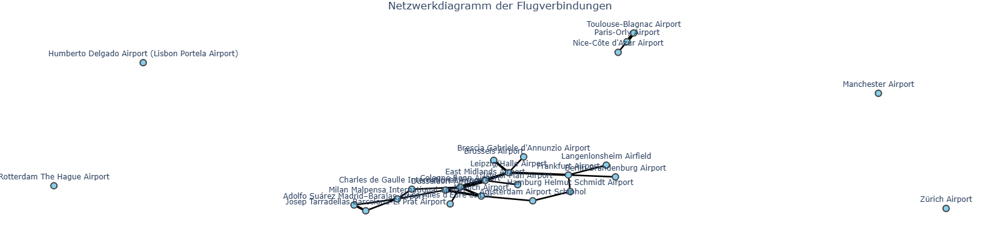

In [15]:
# Beispiel-Daten erweitern: Liste von Flügen
flights_data = flights_rdd.collect()

# Schritt 1: Flugverbindungen aggregieren (Start- und End-Airport-Paare zählen)
connections = defaultdict(int)
start_end_names = {}

for _, _, flight_info in flights_data:
    start_airport = flight_info['start_airport']
    end_airport = flight_info['end_airport']
    
    if start_airport['id'] and end_airport['id']:  # Nur valide Airports berücksichtigen
        start_id, start_name = start_airport['id'], start_airport['name']
        end_id, end_name = end_airport['id'], end_airport['name']
        
        connections[(start_id, end_id)] += 1
        start_end_names[start_id] = start_name
        start_end_names[end_id] = end_name

# Schritt 2: Netzwerkdiagramm erstellen
G = nx.Graph()

# Knoten und Kanten hinzufügen (nur Verbindungen mit mehr als X Flügen)
for (start, end), weight in connections.items():
    if weight > 1:  # Filter: Nur Verbindungen > X
        G.add_edge(start, end, weight=weight)

# Schritt 3: Positionen berechnen
pos = nx.spring_layout(G, seed=42)

# Knoten und Kanten für Plotly vorbereiten
edges_x = []
edges_y = []
weights = []

for edge in G.edges(data=True):
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edges_x.extend([x0, x1, None])
    edges_y.extend([y0, y1, None])
    weights.append(edge[2]['weight'])

# Knoten vorbereiten
nodes_x = []
nodes_y = []
node_text = []

for node in G.nodes():
    x, y = pos[node]
    nodes_x.append(x)
    nodes_y.append(y)
    node_text.append(start_end_names.get(node, node))  # Namen verwenden

# Schritt 4: Interaktives Diagramm mit Plotly erstellen
fig = go.Figure()

# Kanten hinzufügen mit stärkerer Gewichtung
max_weight = max(weights) if weights else 1  # Maximale Gewichtung für Skalierung

for i, edge in enumerate(G.edges(data=True)):
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    fig.add_trace(go.Scatter(
        x=[x0, x1, None],
        y=[y0, y1, None],
        line=dict(width=(weights[i] / max_weight) * 10, color='black'),  # Stärkere Skalierung (100-fach)
        hoverinfo='none',
        mode='lines'))

# Knoten hinzufügen
fig.add_trace(go.Scatter(
    x=nodes_x, y=nodes_y,
    mode='markers+text',
    text=node_text,
    textposition="top center",
    marker=dict(
        size=10,
        color='skyblue',
        line_width=2),
    hoverinfo='text'))

# Layout anpassen
fig.update_layout(
    title="Netzwerkdiagramm der Flugverbindungen",
    title_x=0.5,
    showlegend=False,
    hovermode='closest',
    margin=dict(b=0, l=0, r=0, t=30),
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    plot_bgcolor='white'
)

# Interaktives Diagramm anzeigen
fig.show()


### 2.7 Auswertung - Visualisierung ausgewählter Bewegungsdaten
- Wählt eine bestimmte Flugzeug-Route aus anhand der (`selected_icao`) und zeichnet sie auf einer Folium-Karte.  
- Für das Flugzeug wird die Route zwischen aufeinanderfolgenden Punkten eingezeichnet.  
- Landepunkte (``onground == 1``) werden als grüne Marker mit Informationen über Hersteller, Modell, Airline etc. versehen.  
- Die Karte wird schließlich zentriert auf den ersten Punkt des ersten Flugzeugs.

In [16]:
def analyze_aircraft_route(selected_icao):
    """
    Analysiert die Flugroute eines spezifischen Flugzeugs und erstellt eine interaktive Karte mit der Route und den Landepunkten.

    Diese Funktion filtert die Bewegungsdaten basierend auf der angegebenen Flugzeug-ID (ICAO24-Code) und visualisiert die Flugroute 
    auf einer interaktiven Karte. Die Karte zeigt Linien zwischen den aufeinanderfolgenden Positionspunkten des Flugzeugs und Marker 
    für die Landepunkte an. Weitere Details zu dem Flugzeug (wie Hersteller, Modell und Airline) werden in den Markern angezeigt.

    :param selected_icao: Der ICAO24-Code des Flugzeugs, dessen Route analysiert werden soll.
    
    :return: Eine interaktive `folium.Map`-Karte, die die Flugroute und die Landepunkte des ausgewählten Flugzeugs anzeigt.
            Wenn keine Daten für das angegebene Flugzeug gefunden werden, gibt die Funktion eine Fehlermeldung als String zurück.
    """
    
    filtered_data = combined_rdd.filter(lambda x: x[0] == selected_icao).collect()

    if filtered_data:
        # Hole die Daten für das ausgewählte Flugzeug
        icao24, route_data = filtered_data[0]
        aircraft_info = route_data["aircraft_info"]  # Zugriff auf die Flugzeugbeschreibung
        flight_data = route_data["flight_data"]  # Zugriff auf die Flugdaten

        print(f"Flugzeug-ID: {icao24}")

        # Erstelle die Karte, zentriert auf den ersten Datenpunkt
        first_lat = flight_data[0]["lat"]
        first_lon = flight_data[0]["lon"]
        map = folium.Map(location=[first_lat, first_lon], zoom_start=12)

        # Zeichne Linien zwischen aufeinanderfolgenden Punkten
        for i in range(len(flight_data) - 1):
            point_a = flight_data[i]
            point_b = flight_data[i + 1]

            # Zeichne nur Linien, wenn beide Punkte gültige Koordinaten haben
            if point_a["lat"] and point_a["lon"] and point_b["lat"] and point_b["lon"]:
                folium.PolyLine(
                    locations=[(point_a["lat"], point_a["lon"]), (point_b["lat"], point_b["lon"])],
                    color="blue",
                    weight=2.5,
                    opacity=0.8
                ).add_to(map)

        # Füge Marker nur für Landepunkte hinzu
        for point in flight_data:
            if point["onground"] == 1:  # Nur Landepunkte anzeigen
                folium.Marker(
                    location=(point["lat"], point["lon"]),
                    popup=f"Zeit: {point['time']}<br>Am Boden: {point['onground']}<br>Hersteller: {aircraft_info['manufacturer']}<br>Flugzeugtyp: {aircraft_info['model']}<br>Airline: {aircraft_info['airline']}",
                    icon=folium.Icon(color="green", icon="info-sign")
                ).add_to(map)

        # Rückgabe der Karte
        return map

    else:
        return f"Keine Daten für Flugzeug-ID '{selected_icao}' gefunden."


result = analyze_aircraft_route("4b5c48")
display(result)

Flugzeug-ID: 4b5c48


### 2.8 Auswertung - Visualisierung zufälliger Bewegungsdaten <a id="ausgewählt"></a>
- Wählt zufällig eine bestimmte Anzahl an Flugzeug-Routen aus (`number_of_samples`) und zeichnet sie auf einer Folium-Karte
- Pro Flugzeug wird die Route zwischen aufeinanderfolgenden Punkten in einer zufällig generierten Farbe eingezeichnet
- Landepunkte (``onground == 1``) werden als grüne Marker mit Informationen über Hersteller, Modell, Airline etc. versehen 
- Die Karte wird schließlich zentriert auf den ersten Punkt des ersten Flugzeugs

In [17]:
# Zufällige Farben für die Flugzeuge
def get_random_color():
    """
    Generiert eine zufällige Hex-Farbe.

    Diese Funktion erzeugt eine zufällige Farbe im Hexadezimalformat (z.B. '#a3c113'),
    die für die Visualisierung von Strecken oder Markern verwendet werden kann.

    :return: Eine zufällige Farbe im Hexadezimalformat als String (z.B. '#a3c113').
    """
        
    return "#{:06x}".format(random.randint(0, 0xFFFFFF))

def analyze_aircraft_routes(number_of_samples):
    """
    Analysiert die Routen einer zufälligen Auswahl von Flugzeugen und erstellt eine interaktive Karte.

    Diese Funktion wählt eine angegebene Anzahl zufälliger Flugzeuge aus den Bewegungsdaten aus 
    und visualisiert deren Flugrouten auf einer interaktiven Karte. Die Karte zeigt Linien 
    zwischen den aufeinanderfolgenden Punkten jedes Flugzeugs, sowie Marker für Landepunkte. 
    Jeder Flugzeugroute wird eine zufällige Farbe zugewiesen, und die Marker beinhalten detaillierte 
    Informationen zu Hersteller, Modell und Airline des Flugzeugs.

    :param number_of_samples: Die Anzahl der zufällig auszuwählenden Flugzeuge.
    
    :return: Eine interaktive `folium.Map`-Karte, die die Routen der zufällig ausgewählten Flugzeuge anzeigt.
            Wenn keine Daten gefunden werden, gibt die Funktion eine Fehlermeldung als String zurück.
    """
    
    # Nimm eine beliebige Anzahl zufälliger Flugzeuge aus dem RDD
    random_aircrafts = combined_rdd.takeSample(withReplacement=False, num=number_of_samples)

    # Erstelle eine Karte, zentriert auf einen Beispielpunkt
    if random_aircrafts:
        # Hole den ersten Punkt zur Zentrierung der Karte
        first_lat = random_aircrafts[0][1]["flight_data"][0]["lat"]
        first_lon = random_aircrafts[0][1]["flight_data"][0]["lon"]
        map = folium.Map(location=[first_lat, first_lon], zoom_start=6)

        # Iteriere über die zufälligen Flugzeuge
        for icao24, data in random_aircrafts:
            aircraft_info = data["aircraft_info"]  # Infos über das Flugzeug
            flight_data = data["flight_data"]      # Flugdaten

            # Sichere Abfrage von Typ, Modell und Hersteller mit Standardwerten
            aircraft_type = aircraft_info.get("type", "Unknown")
            aircraft_model = aircraft_info.get("model", "Unknown")
            aircraft_manufacturer = aircraft_info.get("manufacturer", "Unknown")
            aircraft_airline = aircraft_info.get("airline", "Unknown")

            # Generiere eine zufällige Farbe für die Linien
            color = get_random_color()

            # Zeichne Linien zwischen aufeinanderfolgenden Punkten
            for i in range(len(flight_data) - 1):
                point_a = flight_data[i]
                point_b = flight_data[i + 1]

                # Zeichne nur Linien, wenn beide Punkte gültige Koordinaten haben
                if point_a["lat"] and point_a["lon"] and point_b["lat"] and point_b["lon"]:
                    folium.PolyLine(
                        locations=[(point_a["lat"], point_a["lon"]), (point_b["lat"], point_b["lon"])],
                        color=color,
                        weight=2.5,
                        opacity=0.8
                    ).add_to(map)

            # Füge Marker nur für Landepunkte hinzu
            for point in flight_data:
                if point["onground"] == 1:  # Nur Landepunkte anzeigen
                    folium.Marker(
                        location=(point["lat"], point["lon"]),
                        popup=(
                            f"Flugzeug: {icao24}<br>"
                            f"Hersteller: {aircraft_manufacturer}<br>"
                            f"Modell: {aircraft_model}<br>"
                            f"Airline: {aircraft_airline}<br>"
                            f"Zeit: {point['time']}<br>"
                            f"Am Boden: {point['onground']}"
                        ),
                        icon=folium.Icon(color="green", icon="info-sign")
                    ).add_to(map)

        # Zeige die Karte im Notebook
        return map
    else:
        return "Keine Daten gefunden."
    
result = analyze_aircraft_routes(1)
display(result)

### 2.9 Auswertung - Heatmap der Bewegungsdaten <a id="heatmap"></a>

- Extrahiert Koordinaten (Breiten- und Längengrad) aus dem Eingabe-RDD und rundet sie auf eine bestimmte Genauigkeit (hier `round(...)` mit einer Nachkommastelle)
- Aggregiert die Häufigkeiten jeder Koordinatenkombination, um beispielsweise Cluster zu identifizieren  
- Erstellt abschließend eine Heatmap mit Folium basierend auf den gezählten Häufigkeiten

In [18]:
def process_and_reduce(dataRDD, percentage=1.0):
    """
    Verarbeitet das dataRDD, extrahiert die Koordinaten (Breitengrad, Längengrad) 
    und reduziert die Daten, indem die Häufigkeit jedes Koordinatenpaars gezählt wird.
    Gibt das reduzierte RDD der Koordinaten und deren Häufigkeiten zurück.

    Diese Funktion bereinigt die Eingabedaten, indem sie ungültige Koordinaten entfernt und die 
    Häufigkeit jedes Koordinatenpaars zählt. Es wird die Möglichkeit geboten, nur einen Prozentsatz 
    der Daten zu verwenden, was die Verarbeitung von großen Datensätzen effizienter gestaltet.

    :param dataRDD: Das Eingabe-RDD, das Bewegungsdaten von Flugzeugen oder Objekten enthält. 
    :param percentage: Prozentsatz der Daten, die verarbeitet werden sollen (Standardwert: 100%).

    :return: Ein RDD mit den Koordinatenpaaren und deren Häufigkeiten sowie eine Ergebniszusammenfassung als String.
    """

    # Extrahiere Koordinaten
    def extract_coordinates(line):
        try:
            parts = line.split(',')
            return round(float(parts[2]), 1), round(float(parts[3]), 1)  # Breitengrad, Längengrad
        except (ValueError, IndexError):
            return None  # Falls Konvertierung oder Zugriff fehlschlägt

    # Reduktion der Daten
    cleaned_rdd = dataRDD.map(extract_coordinates).filter(lambda x: x is not None)

    # Zähle, wie oft jede Kombination von Breitengrad und Längengrad vorkommt
    reduced_rdd = cleaned_rdd.map(lambda coord: (coord, 1)).reduceByKey(lambda a, b: a + b)

    result = f"Anzahl der Daten vor der Reduktion: {dataRDD.count()}\n"
    result += f"Anzahl Koordinaten nach der Reduktion: {reduced_rdd.count()}\n"

    return reduced_rdd, result


def create_heatmap(reduced_rdd):
    """
    Erstellt eine Heatmap aus den aggregierten Koordinaten und deren Häufigkeiten.

    Diese Funktion nimmt das reduzierte RDD der Koordinaten und deren Häufigkeiten 
    und erstellt eine interaktive Heatmap, die die Dichte der Koordinaten anzeigt. 
    Die Farbe und Intensität der Heatmap-Punkte basiert auf der Häufigkeit der Koordinatenpaare.

    :param reduced_rdd: Ein RDD, das Koordinatenpaare und deren Häufigkeit enthält.

    :return: Eine `folium.Map`-Karte mit der Heatmap der Koordinaten, die die Dichte der Bewegungen anzeigt.
             Gibt eine Fehlermeldung aus, wenn keine gültigen Punkte vorhanden sind.
    """
    
    # Beispiel: Aggregierte Koordinaten mit Häufigkeiten (ersetzt durch deine Daten)
    reduced_data = reduced_rdd.collect()

    # Vorbereitung der Heatmap-Daten
    heatmap_data = [(lat_lon[0], lat_lon[1], count) for lat_lon, count in reduced_data]

    # Erstelle die Karte
    if heatmap_data:
        # Zentriere die Karte auf den ersten Punkt und passe die Zoom-Stufe an
        map = folium.Map(location=[heatmap_data[0][0], heatmap_data[0][1]], zoom_start=6)

        # HeatMap hinzufügen (Radius und max_zoom können angepasst werden)
        HeatMap(heatmap_data, radius=15, max_zoom=13).add_to(map)
        
        return map
    
    else:
        print("Keine gültigen Punkte für die Heatmap gefunden.")



result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path)
reduced_rdd, result = process_and_reduce(dataRDD)
print(result)
map = create_heatmap(reduced_rdd)
display(map)

Anzahl der Daten vor der Reduktion: 13728127
Anzahl Koordinaten nach der Reduktion: 35566



## 3. Analyse der Auswertungen <a id="analyse"></a>


### 3.1 Definition der Analyse-Funktionen
Für die Untersuchung der durchgeführten Analysen werden verschiedene zentrale Funktionen benötigt. Diese werden nachfolgend beschrieben und anschließend für die Analysen verwendet.

- Datenverteilung in RDDs:
  Bestimmt die Anzahl der Datensätze pro Partition sowie die Gesamtzahl der Partitionen und Datensätze der Worker

- Fehlertoleranz im Cluster:
  Die Funktion simuliert den Ausfall einer Worker-Node, führt die Analyse mit oder ohne Ausfall durch und protokolliert die Ergebnisse oder Fehler

- Erfassung der Hardware-Auslastung:
  Ermittlung der aktuellen CPU- und RAM-Auslastung der verwendeten Hardware / des Containers

- Visualisierung von Daten:
  Die von der Skalierbarkeitsanalyse erfassten Daten werden über eine zentrale Funktion visualisiert.

In [19]:
# Datenverteilung im Cluster
def analyze_partition_distribution(rdd):
    """
    Analysiert die Verteilung der Partitionen innerhalb eines RDDs und ermittelt, 
    wie die Daten über die Worker Nodes im Cluster verteilt sind.

    Diese Funktion zählt die Anzahl der Datensätze pro Partition und fasst die 
    Ergebnisse für jeden Worker zusammen. Dadurch kann die Lastverteilung 
    innerhalb des Clusters überprüft werden.

    :param rdd: Ein RDD, dessen Partitionierung analysiert werden soll.

    :return: Gibt eine formatierte Ausgabe mit der Anzahl der Partitionen, 
             der Gesamtanzahl an Datensätzen sowie einer detaillierten Übersicht 
             der Datensatzverteilung pro Partition aus.
    """

    def x(idx, data):
       return [(socket.gethostname(), idx, len(list(data)))]

    stats = rdd.mapPartitionsWithIndex(x).collect()
    print("\n=== Datenverteilungsanalyse ===")

    tmp = {}
    for h, p, c in stats:
        if h not in tmp:
            tmp[h] = []
        tmp[h].append((p, c))

    for h, info in tmp.items():
        s = sum(c for _, c in info)
        print(f"\Hostname: {h}")
        print(f">> Anzahl Partitionen: {len(info)}")
        print(f">> Gesamtanzahl Datensätze: {s}")
        print(">> Verteilung der Datensätze:")
    for p, c in sorted(info):
        print(f"   - Partition {p}: {c} Datensätze")
        
        
# Fehlertoleranz bei Beenden einer Worker Node

def simulate_worker_failure(analyze_func, data_path, worker_pids):
    """
    Diese Funktion führt eine Analyse mit der angegebenen Analysefunktion durch, ermöglicht dem Nutzer 
    das gezielte Beenden eines Worker-Prozesses und wiederholt anschließend die Analyse, um die Auswirkungen 
    des Worker-Ausfalls zu beobachten.

    :param analyze_func: Funktion, die die Analyse durchführt und `data_path` als Argument akzeptiert.
    :param data_path: Pfad zu den zu analysierenden Daten.
    :param worker_pids: Liste der PIDs der aktiven Worker-Prozesse.

    :return: Aktualisierte Liste der verbleibenden Worker-PIDs nach der Simulation.

    Ablauf:
    - Führt die erste Analyse durch und misst die Laufzeit.
    - Zeigt die verfügbaren Worker-PIDs an und erlaubt dem Nutzer, einen Worker-Prozess zu beenden oder keinen zu beenden.
    - Falls mindestens ein Worker übrig bleibt, wird die Analyse erneut durchgeführt und die Zeit gemessen.
    - Gibt die verbleibenden Worker-PIDs zurück oder bricht ab, wenn keine Worker mehr verfügbar sind.
    """

    # Erste Analyse
    print("\nErste Analyse startet...")
    start = time.time()
    analyze_func(data_path)
    time1 = time.time() - start
    print(f"Erste Analyse: {time1:.1f} Sekunden")

    # Worker auswählen und beenden
    print("\nWorker PIDs:", worker_pids)
    choice = input("Welchen Worker beenden? Gibt eine Zahl von 1 - " + str(len(worker_pids)) + " an. Möchtest du nichts beenden gebe 'n' ein!")
    
    if choice != 'n':
        pid = worker_pids[int(choice)-1]
        
        # Prozess mit psutil beenden
        try:
            proc = psutil.Process(pid)
            proc.terminate()  # Alternativ: proc.kill() für sofortiges Beenden
            print(f"Worker {pid} beendet.")
            worker_pids.remove(pid)
        except psutil.NoSuchProcess:
            print(f"Prozess {pid} wurde bereits beendet.")
        
        time.sleep(2)  # Kurz warten
    if len(worker_pids) == 0:
        print("Abbruch - Keine Worker Nodes verfügbar!")
        return worker_pids
    else:

        # Zweite Analyse
        print("\nZweite Analyse startet...")
        start = time.time()
        analyze_func(data_path)
        time2 = time.time() - start
        print(f"Zweite Analyse: {time2:.1f} Sekunden")
        print("Analyse erfolgreich durchgeführt!")

        return worker_pids

# Erfassung der Hardware-Auslastung

def get_executor_metrics():
    """
    Erfasst die aktuellen Systemmetriken für RAM- und CPU-Auslastung.

    Diese Funktion verwendet `psutil`, um die aktuelle Speicherauslastung (RAM) und 
    die Prozessorauslastung (CPU) in Prozent zu ermitteln.

    :return: Ein Tupel mit zwei Werten:
             - `ram_usage_percent` (float): Aktuelle RAM-Auslastung in Prozent.
             - `cpu_usage_percent` (float): Aktuelle CPU-Auslastung in Prozent.
    """

    # RAM-Auslastung
    memory = psutil.virtual_memory()
    ram_usage_percent = memory.percent  # RAM-Auslastung in Prozent

    # CPU-Auslastung
    cpu_usage_percent = psutil.cpu_percent()  # CPU-Auslastung in Prozent - Intervall 0

    return ram_usage_percent, cpu_usage_percent

# Visualisierung der Skalierbarkeit in einem Chart
def plot_results(x_data, y_time, memory_data, cpu_data):
    """
    Visualisiert die Skalierbarkeitsanalyse durch eine grafische Darstellung von Laufzeit, 
    RAM- und CPU-Auslastung in Abhängigkeit von der Datenmenge.

    Die Funktion erstellt ein Diagramm mit drei Y-Achsen:
    - Die erste Y-Achse zeigt die Laufzeit in Sekunden.
    - Die zweite Y-Achse stellt die RAM-Auslastung in Prozent dar.
    - Die dritte Y-Achse zeigt die CPU-Auslastung in Prozent.

    :param x_data: Liste der Datenmengen (in Prozent), die als X-Achsenwerte dienen.
    :param y_time: Liste der Verarbeitungszeiten (in Sekunden) für die jeweiligen Datenmengen.
    :param memory_data: Liste der RAM-Auslastungen (in Prozent) für die jeweiligen Datenmengen.
    :param cpu_data: Liste der CPU-Auslastungen (in Prozent) für die jeweiligen Datenmengen.

    :return: Erstellt und zeigt das Diagramm zur Skalierbarkeitsanalyse an.
    """
    
    fig, ax1 = plt.subplots(figsize=(12, 6))

    # Verarbeitungszeit
    ax1.set_xlabel('Datenmenge (%)')
    ax1.set_ylabel('Laufzeit (Sekunden)', color='b')
    ax1.plot(x_data, y_time, marker='o', linestyle='-', color='b', label='Laufzeit')
    ax1.tick_params(axis='y', labelcolor='b')

    # Zweite Y-Achse für RAM (in Prozent)
    ax2 = ax1.twinx()
    ax2.set_ylabel('RAM-Auslastung (%)', color='r')  # Hier haben wir % für RAM
    ax2.plot(x_data, memory_data, marker='o', linestyle='-', color='r', label='RAM-Auslastung (%)')
    ax2.tick_params(axis='y', labelcolor='r')

    # Dritte Y-Achse für CPU (in Prozent)
    ax3 = ax1.twinx()
    ax3.spines["right"].set_position(("outward", 60))  # Platz für die dritte Y-Achse
    ax3.set_ylabel('CPU-Auslastung (%)', color='y')  # Hier auch % für CPU
    ax3.plot(x_data, cpu_data, marker='o', linestyle='-', color='y', label='CPU-Auslastung (%)')
    ax3.tick_params(axis='y', labelcolor='y')

    # Titel und Layout
    fig.suptitle('Skalierbarkeitsanalyse: Laufzeit, RAM und CPU-Auslastung', fontsize=14)
    fig.tight_layout()
    plt.grid(True)
    plt.show()

### 3.2 Analyse - Weltweite Flughäfen
Für die Auswertung der weltweiten Flughäfen werden folgende Analysen durchgeführt:

- Laufzeit: Erfasst die Ausführungsdauer der Funktion `analyze_airports(...)` mithilfe von `time.time()`
- Datenverteilung: Ruft `analyze_partition_distribution(rdd)` auf und zeigt, wie die im RDD enthaltenen Daten über das Cluster hinweg partitioniert sind

Die Skalierbarkeit und Fehlertoleranz wird für diese Auswertung aufgrund der konstanten Datenmenge nicht untersucht.

**Laufzeit**
- Durchführung der Funktion und Messung der Laufzeit

In [20]:
#Laufzeit
start_time = time.time()
analyze_airports(airport_data_path)
end_time = time.time()
print(f"Die Funktion hat {(end_time - start_time):.4f} Sekunden benötigt")

Die Funktion hat 0.6125 Sekunden benötigt


**Datenverteilung**
- Bestimmung der Gesamtzahl der Datensätze im Dataset
- Untersuchung der Anzahl der Partitionen sowie der Verteilung der Daten über die Partitionen

In [21]:
result = analyze_partition_distribution(airportRDD)


=== Datenverteilungsanalyse ===
\Hostname: cd2d9f58758c
>> Anzahl Partitionen: 2
>> Gesamtanzahl Datensätze: 46880
>> Verteilung der Datensätze:
   - Partition 0: 22588 Datensätze
   - Partition 1: 24292 Datensätze


### 3.3 Analyse - Registrierte Flugobjekte
Für die Auswertung der registrierten Flugobjekte werden folgende Analysen durchgeführt:

- Laufzeit: Stoppt die Zeit vor und nach dem Aufruf der Funktion `analyze_aircraft_data(...)`, um die Ausführungsdauer zu bestimmen
- Datenverteilung: Ruft `analyze_partition_distribution(aircraftRDD)` auf und zeigt an, wie viele Datensätze es insgesamt gibt, wie viele Partitionen vorliegen und wie die Datensätze auf die Partitionen verteilt sind

Die Skalierbarkeit und Fehlertoleranz wird für diese Auswertung aufgrund der konstanten Datenmenge nicht untersucht.



**Laufzeit**
- Durchführung der Funktion und Messung der Laufzeit

In [22]:
#Laufzeit
start_time = time.time()
analyze_aircraft_data(aircraft_data_path)
end_time = time.time()
print(f"Die Funktion hat {(end_time - start_time):.4f} Sekunden benötigt")

Die Funktion hat 2.3671 Sekunden benötigt


**Datenverteilung**
- Bestimmung der Gesamtzahl der Datensätze im Dataset
- Untersuchung der Anzahl der Partitionen sowie der Verteilung der Daten über die Partitionen

In [23]:
# aircraftRDD = aircraftRDD.repartition(1) # Test für Neuverteilung der Daten
analyze_partition_distribution(aircraftRDD)


=== Datenverteilungsanalyse ===
\Hostname: cd2d9f58758c
>> Anzahl Partitionen: 4
>> Gesamtanzahl Datensätze: 4581
>> Verteilung der Datensätze:
   - Partition 0: 785 Datensätze
   - Partition 1: 591 Datensätze
   - Partition 2: 588 Datensätze
   - Partition 3: 2617 Datensätze


### 3.4 Analyse- Bewegungsdaten von Flugobjekten
Für die Auswertung der Bewegungsdaten werden aufgrund der hohen Datenmengen folgende Analysen durchgeführt:

- Laufzeit: Führt die Funktion `analyze_flight_movements` zunächst mit einem sehr kleinen Prozentsatz der Daten (0.01%) und anschließend mit allen Daten (100%) aus und misst die dafür benötigte Zeit (Basismessung)
- Datenverteilung: Gibt die Anzahl an Datensätzen und deren Verteilung auf die einzelnen Partitionen aus
- Fehlertoleranz: Analysiert, wie sich die Funktion bei Aufall einer Worker Node im Cluster verhält
- Skalierbarkeit: Untersucht die Performance des Clusters (Laufzeit der Analyse) in Abhängigkeit der analysierten Datenmenge

**Laufzeit**
- Durchführung der Funktion mit einer minimalen Teilmenge der Daten, um eine Basismessung der benötigten Zeit zu erhalten
- Ausgabe der Laufzeit bei der Verarbeitung aller Daten, abzüglich der Basiszeit

In [24]:
# Basiszeit

# Startzeit messen
start_time = time.time()

# Funktionen aufrufen
result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=0.0001)
virtual_memory = psutil.virtual_memory()  # Virtueller Speicher (RAM)
used_memory = virtual_memory.used  # Genutzter RAM
memory_percent = virtual_memory.percent  # Prozentsatz des verwendeten RAM

# Endzeit messen
end_time = time.time()

# Basiszeit errechnen
base_time = end_time - start_time

# Laufzeit

# Startzeit messen
start_time = time.time()

# Funktion aufrufen
result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=1.0)

# Endzeit messen
end_time = time.time()

print(f"Die Funktion hat für 100% der Daten {(end_time - start_time - base_time):.4f} Sekunden benötigt")


Die Funktion hat für 100% der Daten 21.0419 Sekunden benötigt


**Datenverteilung**
- Bestimmung der Gesamtzahl der Datenpunkte im Dataset
- Untersuchung der Anzahl der Partitionen sowie der Verteilung der Daten über die Partitionen

In [25]:
# Datenverteilung
analyze_partition_distribution(dataRDD)


=== Datenverteilungsanalyse ===
\Hostname: cd2d9f58758c
>> Anzahl Partitionen: 28
>> Gesamtanzahl Datensätze: 13728127
>> Verteilung der Datensätze:
   - Partition 0: 501118 Datensätze
   - Partition 1: 500729 Datensätze
   - Partition 2: 500584 Datensätze
   - Partition 3: 500246 Datensätze
   - Partition 4: 500549 Datensätze
   - Partition 5: 500619 Datensätze
   - Partition 6: 501023 Datensätze
   - Partition 7: 500649 Datensätze
   - Partition 8: 500685 Datensätze
   - Partition 9: 500206 Datensätze
   - Partition 10: 499597 Datensätze
   - Partition 11: 500848 Datensätze
   - Partition 12: 500642 Datensätze
   - Partition 13: 500639 Datensätze
   - Partition 14: 500723 Datensätze
   - Partition 15: 500372 Datensätze
   - Partition 16: 500611 Datensätze
   - Partition 17: 499668 Datensätze
   - Partition 18: 500516 Datensätze
   - Partition 19: 500522 Datensätze
   - Partition 20: 500010 Datensätze
   - Partition 21: 500508 Datensätze
   - Partition 22: 500537 Datensätze
   - Part

**Fehlertoleranz**
- Durchführung einer Analyse im Spark Cluster
- Optional: Händisches beenden ("killen") einer Worker Node im Cluster
- Ausgabe eines Protokolls, dass die benötigte Zeit der Analyse zeigt
- Cluster wird neugestartet falls eine Node bei der Analyse der Fehlertoleranz beendet wurde

In [26]:
worker_pids = simulate_worker_failure(analyze_flight_movements, flight_data_path, worker_pids)

if len(worker_pids) != WORKER_INSTANCES:
    print("")
    print("==== Cluster neustarten mit allen Nodes ====")
    worker_pids = setup_spark_cluster(
        worker_count=WORKER_INSTANCES,
        worker_cores=WORKER_CORES,
        worker_memory=WORKER_MEMORY
    )

    spark.stop()
    spark = create_spark_session(worker_memory)

    # Versuch, den SparkContext zu erstellen
    try:
        sc = spark.sparkContext  # Verwende den SparkContext aus der SparkSession
        print("SparkContext erfolgreich erstellt.")
        print(f"Spark läuft auf Master: {sc.master}")
    except Exception as e:
        print(f"Fehler beim Erstellen des SparkContext: {e}")


Erste Analyse startet...
Erste Analyse: 66.3 Sekunden

Worker PIDs: [458, 580]


Welchen Worker beenden? Gibt eine Zahl von 1 - 2 an. Möchtest du nichts beenden gebe 'n' ein! 1


Worker 458 beendet.

Zweite Analyse startet...
Zweite Analyse: 131.3 Sekunden
Analyse erfolgreich durchgeführt!

==== Cluster neustarten mit allen Nodes ====

=== Starte Spark Cluster Setup ===
Worker Count: 2
Cores pro Worker: 1
Memory pro Worker: 2g
Beende vorhandene Spark-Prozesse...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-master.sh
Warte auf Master-Start...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-worker.sh
Cluster-Setup abgeschlossen!
Aktive Worker PIDs: [9401, 9527]
SparkContext erfolgreich erstellt.
Spark läuft auf Master: spark://127.0.0.1:7077



Zweite Analyse startet...
Zweite Analyse: -1.6 Sekunden
Analyse erfolgreich durchgeführt!


**Skalierbarkeit**
- Definiert verschiedene Datenmengen (10%, 20%, 50%, 100%) zur Analyse der Verarbeitungseffizienz
- Misst die Ausführungszeit der Funktionen für jede Datenmenge
- Speicherauslastung: Erfasst die RAM-Auslastung im Cluster unmittelbar der Verarbeitung
- CPU-Auslastung: Misst die CPU-Auslastung im Cluster unmittelbar nach der Verarbeitung
- Datenvisualisierung: Erstellt ein Diagramm zur Darstellung der gesammelten Leistungsmetriken in Abhängigkeit von der verarbeiteten Datenmenge:
  1. Verarbeitungszeit vs. Datenmenge (Sekunden)
  2. RAM-Auslastung vs. Datenmenge (%)
  3. CPU-Auslastung vs. Datenmenge (%)


Verarbeite 10.0% der Daten...

Verarbeite 20.0% der Daten...

Verarbeite 50.0% der Daten...

Verarbeite 100.0% der Daten...


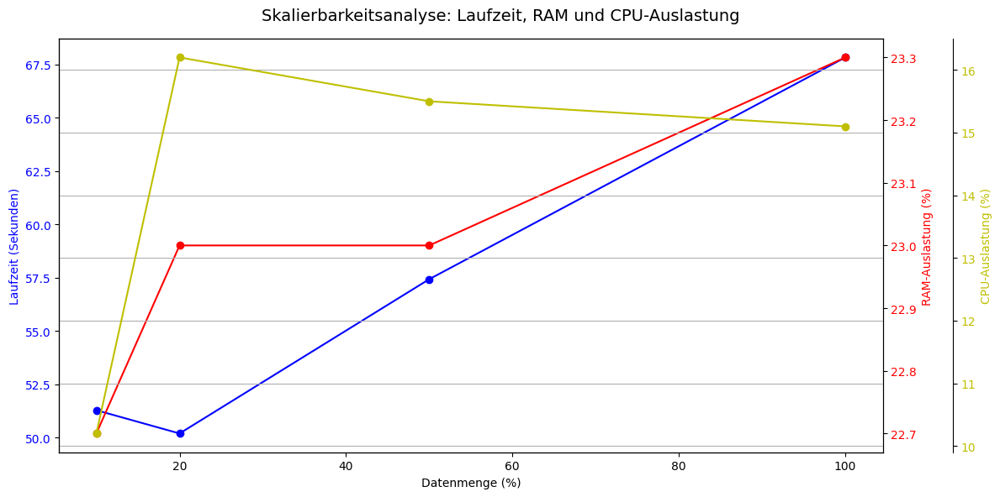

In [27]:
# Skalierbarkeit

# Definition der zu verarbeitenden Datenmenge
percentages = [0.1, 0.2, 0.5, 1.0]  # 10%, 20%, 50%, 100%

# Listen für Plot vorbereiten
x_data = []
y_time = []
memory_data = []
cpu_data = []

for percentage in percentages:
    print(f"\nVerarbeite {percentage*100}% der Daten...")

    # Startzeit messen
    start_time = time.time()

    # Funktion aufrufen
    result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=percentage)
    
    # Cluster-Metriken abrufen
    total_memory, total_cpu = get_executor_metrics()

    # Endzeit messen
    end_time = time.time()

    # Daten für den Plot sammeln
    x_data.append(percentage * 100)  # Prozentuale Datenmenge
    y_time.append(end_time - start_time)  # Verarbeitungszeit
    memory_data.append(total_memory)  # Speicherauslastung in %
    cpu_data.append(total_cpu)  # CPU-Auslastung in %

plot_results(x_data, y_time, memory_data, cpu_data)

### 3.5 Analyse - Kombination Flugobjekte und Bewegungsdaten

Für die Auswertung der kombinierten Flugobjekte und Bewegungsdaten werden aufgrund der hohen Datenmengen folgende Analysen durchgeführt:

- Laufzeit:
  - Führt die Funktionen `analyze_flight_movements`, `restructure_flight_movements`, `analyze_aircraft_data`, `combine_rdds` und `analyze_combined_rdd` mit einem sehr kleinen Datenanteil (`0.01%`) aus
  - Misst die dafür benötigte Zeit, um eine Basiszeit (`base_time`) zu bestimmen
  
- Laufzeitmessung:
  - Führt dieselben Funktionen mit `100%` der Daten aus
  - Misst die gesamte Ausführungszeit und subtrahiert die zuvor ermittelte Basiszeit, um die tatsächliche Verarbeitungszeit zu berechnen
  
- Datenverteilung:
  - Analysiert die Verteilung der Daten im kombinierten RDD über die verschiedenen Partitionen mithilfe der Funktion `analyze_partition_distribution`
  
- Ausgabe:
  - Gibt die berechnete Laufzeit für die Verarbeitung der vollständigen Datenmenge sowie die Ergebnisse der Datenverteilungsanalyse aus

**Laufzeit**
- Durchführung der Funktion mit einer minimalen Teilmenge der Daten, um eine Basismessung der benötigten Zeit zu erhalten
- Ausgabe der Laufzeit bei der Verarbeitung aller Daten, abzüglich der Basiszeit

In [28]:
# Basiszeit

# Startzeit messen
start_time = time.time() 

# Funktionen aufrufen
result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=0.0001) #0.01% der Daten für Basiszeit
vehicle_rdd = restructure_flight_movements(dataRDD)
result, aircraft_raw_rdd, aircraftRDD = analyze_aircraft_data(aircraft_data_path)
combined_rdd = combine_rdds(vehicle_rdd, aircraft_raw_rdd)
combined_analyzed_rdd, result = analyze_combined_rdd(combined_rdd, 0.0001) #0.01% der Daten für Basiszeit

# Endzeit messen
end_time = time.time()

#Basiszeit errechnen
base_time = end_time-start_time


# Laufzeit

# Startzeit messen
start_time = time.time()

# Funktionen aufrufen
result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path)
vehicle_rdd = restructure_flight_movements(dataRDD)    
result, aircraft_raw_rdd, aircraftRDD = analyze_aircraft_data(aircraft_data_path)
combined_rdd = combine_rdds(vehicle_rdd, aircraft_raw_rdd)
combined_analyzed_rdd, result = analyze_combined_rdd(combined_rdd)

# Endzeit messen
end_time = time.time()

print(f"Die Funktion hat für 100% der Daten {end_time - start_time:.4f} Sekunden benötigt")

Die Funktion hat für 100% der Daten 141.4755 Sekunden benötigt


**Datenverteilung**
- Bestimmung der Gesamtzahl der Datenpunkte im Dataset
- Untersuchung der Anzahl der Partitionen sowie der Verteilung der Daten über die Partitionen

In [29]:
analyze_partition_distribution(combined_analyzed_rdd)


=== Datenverteilungsanalyse ===
\Hostname: cd2d9f58758c
>> Anzahl Partitionen: 32
>> Gesamtanzahl Datensätze: 3165
>> Verteilung der Datensätze:
   - Partition 0: 92 Datensätze
   - Partition 1: 98 Datensätze
   - Partition 2: 108 Datensätze
   - Partition 3: 100 Datensätze
   - Partition 4: 101 Datensätze
   - Partition 5: 95 Datensätze
   - Partition 6: 106 Datensätze
   - Partition 7: 82 Datensätze
   - Partition 8: 95 Datensätze
   - Partition 9: 101 Datensätze
   - Partition 10: 98 Datensätze
   - Partition 11: 84 Datensätze
   - Partition 12: 97 Datensätze
   - Partition 13: 105 Datensätze
   - Partition 14: 104 Datensätze
   - Partition 15: 94 Datensätze
   - Partition 16: 101 Datensätze
   - Partition 17: 88 Datensätze
   - Partition 18: 99 Datensätze
   - Partition 19: 92 Datensätze
   - Partition 20: 102 Datensätze
   - Partition 21: 93 Datensätze
   - Partition 22: 99 Datensätze
   - Partition 23: 96 Datensätze
   - Partition 24: 105 Datensätze
   - Partition 25: 86 Datensä

**Fehlertoleranz**
- Durchführung einer Analyse im Spark Cluster
- Optional: Händisches beenden ("killen") einer Worker Node im Cluster
- Ausgabe eines Protokolls, dass die benötigte Zeit der Analyse zeigt
- Cluster wird neugestartet falls eine Node bei der Analyse der Fehlertoleranz beendet wurde

In [30]:
worker_pids = simulate_worker_failure(analyze_flight_movements, flight_data_path, worker_pids)

if len(worker_pids) != WORKER_INSTANCES:
    print("")
    print("==== Cluster neustarten mit allen Nodes ====")
    worker_pids = setup_spark_cluster(
        worker_count=WORKER_INSTANCES,
        worker_cores=WORKER_CORES,
        worker_memory=WORKER_MEMORY
    )

    spark.stop()
    spark = create_spark_session(worker_memory)

    # Versuch, den SparkContext zu erstellen
    try:
        sc = spark.sparkContext  # Verwende den SparkContext aus der SparkSession
        print("SparkContext erfolgreich erstellt.")
        print(f"Spark läuft auf Master: {sc.master}")
    except Exception as e:
        print(f"Fehler beim Erstellen des SparkContext: {e}")


Erste Analyse startet...
Erste Analyse: 66.9 Sekunden

Worker PIDs: [9401, 9527]


Welchen Worker beenden? Gibt eine Zahl von 1 - 2 an. Möchtest du nichts beenden gebe 'n' ein! 2


Worker 9527 beendet.

Zweite Analyse startet...
Zweite Analyse: 127.6 Sekunden
Analyse erfolgreich durchgeführt!

==== Cluster neustarten mit allen Nodes ====

=== Starte Spark Cluster Setup ===
Worker Count: 2
Cores pro Worker: 1
Memory pro Worker: 2g
Beende vorhandene Spark-Prozesse...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-master.sh
Warte auf Master-Start...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-worker.sh
Cluster-Setup abgeschlossen!
Aktive Worker PIDs: [19349, 19482]
SparkContext erfolgreich erstellt.
Spark läuft auf Master: spark://127.0.0.1:7077



Zweite Analyse startet...
Zweite Analyse: 0.7 Sekunden
Analyse erfolgreich durchgeführt!


**Skalierbarkeit**
- Definiert verschiedene Datenmengen (10%, 20%, 50%, 100%) zur Analyse der Verarbeitungseffizienz
- Misst die Ausführungszeit der Funktionen für jede Datenmenge
- Speicherauslastung: Erfasst die RAM-Auslastung im Cluster unmittelbar der Verarbeitung
- CPU-Auslastung: Misst die CPU-Auslastung im Cluster unmittelbar nach der Verarbeitung
- Datenvisualisierung: Erstellt ein Diagramm zur Darstellung der gesammelten Leistungsmetriken in Abhängigkeit von der verarbeiteten Datenmenge:
  1. Verarbeitungszeit vs. Datenmenge (Sekunden)
  2. RAM-Auslastung vs. Datenmenge (%)
  3. CPU-Auslastung vs. Datenmenge (%)


Verarbeite 10.0% der Daten...

Verarbeite 20.0% der Daten...

Verarbeite 50.0% der Daten...

Verarbeite 100.0% der Daten...


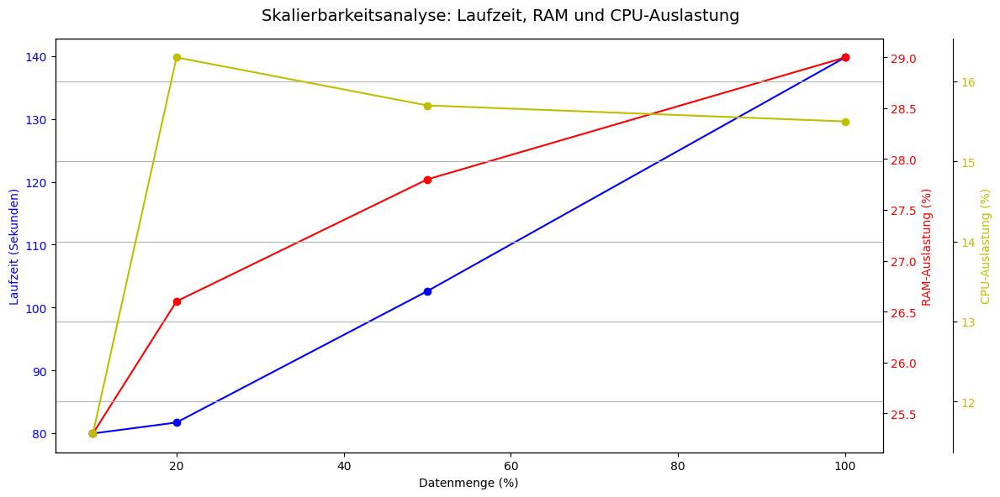

In [31]:
# Definition der zu verarbeitenden Datenmenge
percentages = [0.1, 0.2, 0.5, 1.0]  # 10%, 20%, 50%, 100%

# Listen für Plot vorbereiten
x_data = []
y_time = []
memory_data = []
cpu_data = []

for percentage in percentages:
    print(f"\nVerarbeite {percentage*100}% der Daten...")
    
    # Startzeit messen
    start_time = time.time()

    # Funktionen aufrufen
    result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=percentage)
    vehicle_rdd = restructure_flight_movements(dataRDD)
    result, aircraft_raw_rdd, aircraftRDD = analyze_aircraft_data(aircraft_data_path)
    combined_rdd = combine_rdds(vehicle_rdd, aircraft_raw_rdd)
    combined_analyzed_rdd, result = analyze_combined_rdd(combined_rdd, percentage)
    
    # Cluster-Metriken abrufen
    total_memory, total_cpu = get_executor_metrics()

    # Endzeit messen
    end_time = time.time()

    # Daten für den Plot sammeln
    x_data.append(percentage * 100)  # Prozentuale Datenmenge
    y_time.append(end_time - start_time)  # Verarbeitungszeit
    memory_data.append(total_memory)  # Speicherauslastung in %
    cpu_data.append(total_cpu)  # CPU-Auslastung in %
  
# Ergebnisse plotten
plot_results(x_data, y_time, memory_data, cpu_data)

### 3.6 Analyse - Heatmap der Bewegungsdaten
Für die Auswertung der Bewegungsdaten werden aufgrund der hohen Datenmengen folgende Analysen durchgeführt:

- Laufzeit:
  - Führt die Funktionen `analyze_flight_movements`, `process_and_reduce` und `create_heatmap` mit einem sehr kleinen Datenanteil (`0.01%`) aus
  - Misst die dafür benötigte Zeit (`base_time`), um eine Basiszeit zu bestimmen
  - Führt dieselben Funktionen mit `100%` der Daten aus
  - Misst die gesamte Ausführungszeit und subtrahiert die zuvor ermittelte Basiszeit, um die tatsächliche Verarbeitungszeit zu berechnen
  
- Datenverteilung: Analysiert die Verteilung der Daten im reduzierten RDD über die verschiedenen Partitionen mithilfe der Funktion `analyze_partition_distribution`
  
- Ausgabe:
  - Gibt die berechnete Laufzeit für die Verarbeitung der vollständigen Datenmenge sowie die Ergebnisse der Datenverteilungsanalyse aus
  - Erstellt und zeigt eine Heatmap basierend auf den reduzierten Koordinaten

**Laufzeit**
- Durchführung der Funktion mit einer minimalen Teilmenge der Daten, um eine Basismessung der benötigten Zeit zu erhalten
- Ausgabe der Laufzeit bei der Verarbeitung aller Daten, abzüglich der Basiszeit

In [32]:
# Basiszeit

# Startzeit messen
start_time = time.time()

# Funktionen aufrufen
result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=0.0001)
reduced_rdd, result = process_and_reduce(dataRDD)
map = create_heatmap(reduced_rdd)

# Endzeit messen
end_time = time.time()

# Basiszeit errechenen
base_time = end_time-start_time


# Laufzeit

# Startzeit messen
start_time = time.time()

# Funktionen aufrufen
result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path)
reduced_rdd, result = process_and_reduce(dataRDD)
print(result)
map = create_heatmap(reduced_rdd)

# Endzeit messen
end_time = time.time()

print(f"Die Funktion hat für 100% der Daten {(end_time - start_time - base_time):.4f} Sekunden benötigt")

Anzahl der Daten vor der Reduktion: 13728127
Anzahl Koordinaten nach der Reduktion: 35566

Die Funktion hat für 100% der Daten 34.9963 Sekunden benötigt


**Datenverteilung**
- Bestimmung der Gesamtzahl der Datenpunkte im Dataset
- Untersuchung der Anzahl der Partitionen sowie der Verteilung der Daten über die Partitionen

In [33]:
analyze_partition_distribution(reduced_rdd)


=== Datenverteilungsanalyse ===
\Hostname: cd2d9f58758c
>> Anzahl Partitionen: 28
>> Gesamtanzahl Datensätze: 35566
>> Verteilung der Datensätze:
   - Partition 0: 1264 Datensätze
   - Partition 1: 1283 Datensätze
   - Partition 2: 1280 Datensätze
   - Partition 3: 1264 Datensätze
   - Partition 4: 1263 Datensätze
   - Partition 5: 1313 Datensätze
   - Partition 6: 1244 Datensätze
   - Partition 7: 1259 Datensätze
   - Partition 8: 1283 Datensätze
   - Partition 9: 1302 Datensätze
   - Partition 10: 1224 Datensätze
   - Partition 11: 1225 Datensätze
   - Partition 12: 1280 Datensätze
   - Partition 13: 1290 Datensätze
   - Partition 14: 1229 Datensätze
   - Partition 15: 1218 Datensätze
   - Partition 16: 1276 Datensätze
   - Partition 17: 1257 Datensätze
   - Partition 18: 1295 Datensätze
   - Partition 19: 1222 Datensätze
   - Partition 20: 1301 Datensätze
   - Partition 21: 1292 Datensätze
   - Partition 22: 1281 Datensätze
   - Partition 23: 1268 Datensätze
   - Partition 24: 1302

**Fehlertoleranz**
- Durchführung einer Analyse im Spark Cluster
- Optional: Händisches beenden ("killen") einer Worker Node im Cluster
- Ausgabe eines Protokolls, dass die benötigte Zeit der Analyse zeigt
- Cluster wird neugestartet falls eine Node bei der Analyse der Fehlertoleranz beendet wurde

In [34]:
worker_pids = simulate_worker_failure(process_and_reduce, dataRDD, worker_pids) # Visualisierung findet bei Client statt, somit nicht relevant für Cluster

if len(worker_pids) != WORKER_INSTANCES:
    print("")
    print("==== Cluster neustarten mit allen Nodes ====")
    worker_pids = setup_spark_cluster(
        worker_count=WORKER_INSTANCES,
        worker_cores=WORKER_CORES,
        worker_memory=WORKER_MEMORY
    )

    spark.stop()
    spark = create_spark_session(worker_memory)

    # Versuch, den SparkContext zu erstellen
    try:
        sc = spark.sparkContext  # Verwende den SparkContext aus der SparkSession
        print("SparkContext erfolgreich erstellt.")
        print(f"Spark läuft auf Master: {sc.master}")
    except Exception as e:
        print(f"Fehler beim Erstellen des SparkContext: {e}")


Erste Analyse startet...
Erste Analyse: 28.8 Sekunden

Worker PIDs: [19349, 19482]


Welchen Worker beenden? Gibt eine Zahl von 1 - 2 an. Möchtest du nichts beenden gebe 'n' ein! 2


Worker 19482 beendet.

Zweite Analyse startet...
Zweite Analyse: 54.9 Sekunden
Analyse erfolgreich durchgeführt!

==== Cluster neustarten mit allen Nodes ====

=== Starte Spark Cluster Setup ===
Worker Count: 2
Cores pro Worker: 1
Memory pro Worker: 2g
Beende vorhandene Spark-Prozesse...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-master.sh
Warte auf Master-Start...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-worker.sh
Cluster-Setup abgeschlossen!
Aktive Worker PIDs: [32582, 32708]
SparkContext erfolgreich erstellt.
Spark läuft auf Master: spark://127.0.0.1:7077


Worker 21189 beendet.

Zweite Analyse startet...
Zweite Analyse: 0.6 Sekunden
Analyse erfolgreich durchgeführt!

==== Cluster neustarten mit allen Nodes ====

=== Starte Spark Cluster Setup ===
Worker Count: 2
Cores pro Worker: 1
Memory pro Worker: 2g
Beende vorhandene Spark-Prozesse...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-master.sh
Warte auf Master-Start...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-worker.sh
Cluster-Setup abgeschlossen!
Aktive Worker PIDs: [28638, 28763]
SparkContext erfolgreich erstellt.
Spark läuft auf Master: spark://127.0.0.1:7077


**Skalierbarkeit**
- Definiert verschiedene Datenmengen (10%, 20%, 50%, 100%) zur Analyse der Verarbeitungseffizienz
- Misst die Ausführungszeit der Funktionen für jede Datenmenge
- Speicherauslastung: Erfasst die RAM-Auslastung im Cluster unmittelbar der Verarbeitung
- CPU-Auslastung: Misst die CPU-Auslastung im Cluster unmittelbar nach der Verarbeitung
- Datenvisualisierung: Erstellt ein Diagramm zur Darstellung der gesammelten Leistungsmetriken in Abhängigkeit von der verarbeiteten Datenmenge:
  1. Verarbeitungszeit vs. Datenmenge (Sekunden)
  2. RAM-Auslastung vs. Datenmenge (%)
  3. CPU-Auslastung vs. Datenmenge (%)


Verarbeite 10.0% der Daten...

Verarbeite 20.0% der Daten...

Verarbeite 50.0% der Daten...

Verarbeite 100.0% der Daten...


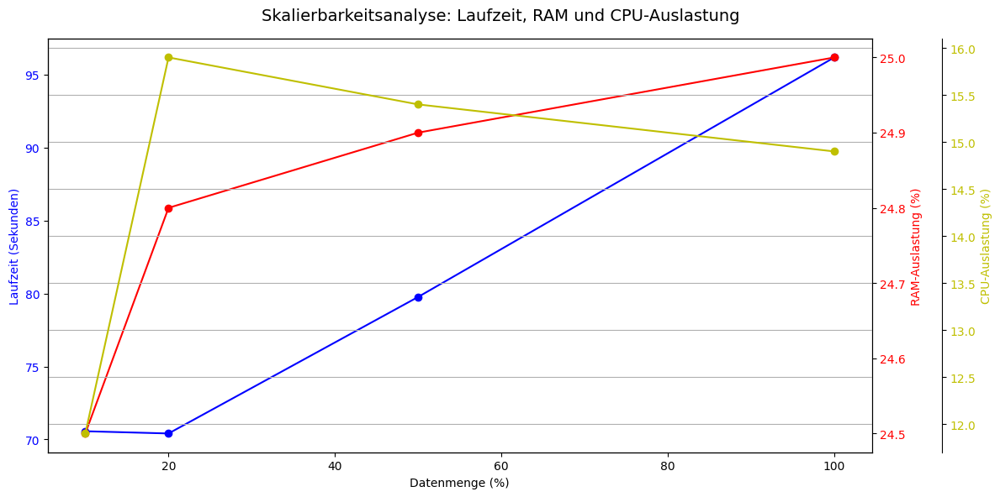

In [35]:
# Skalierbarkeit
percentages = [0.1, 0.2, 0.5, 1.0]  # 10%, 20%, 50%, 100%

# Listen für Plot vorbereiten
x_data = []
y_time = []
memory_data = []
cpu_data = []

for percentage in percentages:
    print(f"\nVerarbeite {percentage*100}% der Daten...")

    # Startzeit messen
    start_time = time.time()

    # Funktionen aufrufen
    result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=percentage)
    reduced_rdd, result = process_and_reduce(dataRDD)
    map = create_heatmap(reduced_rdd)

    # Cluster-Metriken abrufen
    total_memory, total_cpu = get_executor_metrics()

    # Endzeit messen
    end_time = time.time()

    # Daten für den Plot sammeln
    x_data.append(percentage * 100)  # Prozentuale Datenmenge
    y_time.append(end_time - start_time)  # Verarbeitungszeit
    memory_data.append(total_memory)  # Speicherauslastung in %
    cpu_data.append(total_cpu)  # CPU-Auslastung in %

# Ergebnisse plotten
plot_results(x_data, y_time, memory_data, cpu_data)

### 3.7 Analyse - Skalierbarkeit bei veränderten Ressourcen
Um nebend der Veränderung der Datenmenge auch das Verhalten bei veränderten Ressourcen und identischer Datenmenge zu untersuchen, werden folgende Schritte durchgeführt:
1. Ausführung der Analyse: analyze_flight_movements bei aktueller Konfiguration des Clusters
2. Visualisierung der Ergebnisse
3. Verdopplung der Hardware-Ressourcen im Spark Cluster
4. Erneute Ausführung der Analyse: analyze_flight_movements
5. Visualisierung der Ergebnisse
6. Vergleich der visualisierten Auswertungen mit und ohne verdoppelte Ressourcen 


Verarbeite 10.0% der Daten...

Verarbeite 20.0% der Daten...

Verarbeite 50.0% der Daten...

Verarbeite 100.0% der Daten...


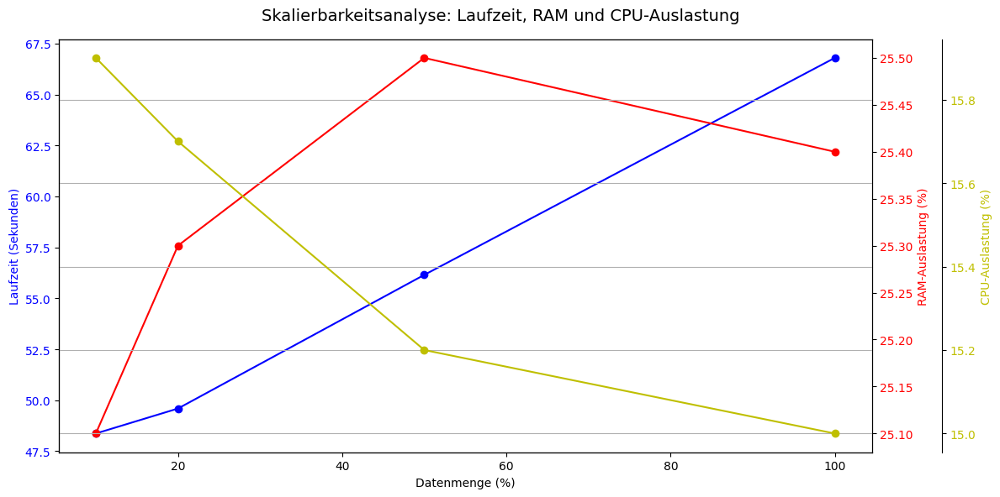


=== Beende Spark Cluster ===
Beende vorhandene Spark-Prozesse...
Alle Spark-Prozesse beendet.

=== Verdopple Ressourcen: Anzahl Worker und CPU-Kerne ===

==== Cluster neustarten mit allen Nodes ====

=== Starte Spark Cluster Setup ===
Worker Count: 4
Cores pro Worker: 2
Memory pro Worker: 4g
Beende vorhandene Spark-Prozesse...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-master.sh
Warte auf Master-Start...
Starte Prozess mit Skript: /usr/local/spark-3.5.0-bin-hadoop3/sbin/start-worker.sh
Warte auf Worker...
Cluster-Setup abgeschlossen!
Aktive Worker PIDs: [40982, 41114, 41235, 41363]
SparkContext erfolgreich erstellt.
Spark läuft auf Master: spark://127.0.0.1:7077

Verarbeite 10.0% der Daten mit verdoppelten Ressourcen...

Verarbeite 20.0% der Daten mit verdoppelten Ressourcen...

Verarbeite 50.0% der Daten mit verdoppelten Ressourcen...

Verarbeite 100.0% der Daten mit verdoppelten Ressourcen...


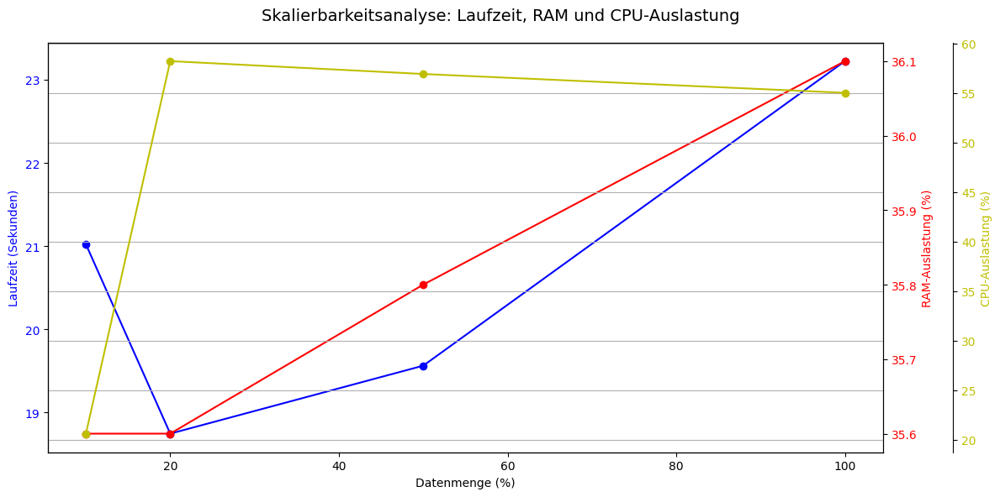

In [36]:
# Skalierbarkeit

# Definition der zu verarbeitenden Datenmenge
percentages = [0.1, 0.2, 0.5, 1.0]  # 10%, 20%, 50%, 100%

# Listen für Plot vorbereiten
x_data = []
y_time = []
memory_data = []
cpu_data = []

for percentage in percentages:
    print(f"\nVerarbeite {percentage*100}% der Daten...")

    # Startzeit messen
    start_time = time.time()

    # Funktion aufrufen
    result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=percentage)
    
    # Cluster-Metriken abrufen
    total_memory, total_cpu = get_executor_metrics()

    # Endzeit messen
    end_time = time.time()

    # Daten für den Plot sammeln
    x_data.append(percentage * 100)  # Prozentuale Datenmenge
    y_time.append(end_time - start_time)  # Verarbeitungszeit
    memory_data.append(total_memory)  # Speicherauslastung in %
    cpu_data.append(total_cpu)  # CPU-Auslastung in %

plot_results(x_data, y_time, memory_data, cpu_data)

cleanup_spark_cluster()
time.sleep(5)

# Ressourcen verdoppeln
print("\n=== Verdopple Ressourcen: Anzahl Worker und CPU-Kerne ===")
WORKER_INSTANCES *= 2
WORKER_CORES *= 2
memory_value = int(WORKER_MEMORY[:-1])  # Entfernt das 'g' und konvertiert den Wert in eine Zahl
WORKER_MEMORY = f"{memory_value * 2}g"  #

# Spark-Cluster mit verdoppelten Ressourcen starten

print("")
print("==== Cluster neustarten mit allen Nodes ====")
worker_pids = setup_spark_cluster(
    worker_count=WORKER_INSTANCES,
    worker_cores=WORKER_CORES,
    worker_memory=WORKER_MEMORY
)

spark.stop()

worker_memory = WORKER_MEMORY
spark = create_spark_session(worker_memory)

# Versuch, den SparkContext zu erstellen
try:
    sc = spark.sparkContext  # Verwende den SparkContext aus der SparkSession
    print("SparkContext erfolgreich erstellt.")
    print(f"Spark läuft auf Master: {sc.master}")
except Exception as e:
    print(f"Fehler beim Erstellen des SparkContext: {e}")

# Skalierbarkeit nach Verdopplung der Ressourcen messen
x_data_doubled = []
y_time_doubled = []
memory_data_doubled = []
cpu_data_doubled = []

percentages = [0.1, 0.2, 0.5, 1.0]  # 10%, 20%, 50%, 100%


for percentage in percentages:
    print(f"\nVerarbeite {percentage*100}% der Daten mit verdoppelten Ressourcen...")

    # Startzeit messen
    start_time = time.time()

    # Funktion aufrufen
    result_text, map_result, dataRDD = analyze_flight_movements(flight_data_path, percentage=percentage)
    
    # Cluster-Metriken abrufen
    total_memory, total_cpu = get_executor_metrics()

    # Endzeit messen
    end_time = time.time()

    # Daten für den Plot sammeln
    x_data_doubled.append(percentage * 100)  # Prozentuale Datenmenge
    y_time_doubled.append(end_time - start_time)  # Verarbeitungszeit
    memory_data_doubled.append(total_memory)  # Speicherauslastung in %
    cpu_data_doubled.append(total_cpu)  # CPU-Auslastung in %


# Ergebnisse nach Verdopplung der Ressourcen plotten
plot_results(x_data_doubled, y_time_doubled, memory_data_doubled, cpu_data_doubled)

================================================================================================================================================================================

## 4. Experimente

### 4.1 Vorverarbeitung der Datenquelle
Für die Vorverarbeitung der Bewegungsdaten haben wir eine Python-Funktion genutzt, welche wir nachfolgend erwähnen wollen.
- Code auskommentiert, soll aber die Vorverarbeitung der Bewegungsdaten aufzeigen bevor RDDs angelegt wurden
- Nur notwendig für Vorverarbeitung von Bewegungsdaten zur Umwandlung in notwendiges Datenformat
- Laden: Liest eine Pipe-getrennte CSV-Datei ein (z.B. `data.csv` - diese umfasste alle von OpenSky Network exportierten Daten und ist nicht im Datensatz der Abgabe enthalten aufgrund des hohen Datenvolumens)
- Spalten auswählen und umbenennen: Wählt die Spalten `icao24`, `time`, `latitude`, `longitude`, `onground` aus und benennt sie um
- Daten konvertieren:
    - Zeit: Wandelt Unix-Timestamps in lesbares Format um
    - Status: Konvertiert `onground` von `true`/`false` zu `1`/`0`
- Speichern: Speichert die bereinigten Daten in `processed_data.csv`

In [37]:
# CSV-Datei laden, wobei das Pipe-Zeichen als Trennzeichen angegeben wird
#csv_file_path = "data.csv"  # Ersetze dies mit dem Pfad zu deiner CSV-Datei
#df = pd.read_csv(csv_file_path, sep='|')  # Verwende '|' als Trennzeichen

# Angenommene Spaltennummern: time = 0, icao24 = 1, lat = 2, lon = 3, onground = 4
#column_indices = [1, 0, 2, 3, 4]  # Die Spalten in der gewünschten Reihenfolge auswählen
#df_selected = df.iloc[:, column_indices]

# Umbenennen der Spalten
#df_selected.columns = ['time', 'icao24', 'latitude', 'longitude', 'onground']

# Funktion zur Konvertierung des Unix-Timestamps
#def convert_timestamp(unix_timestamp):
#    try:
#        return datetime.utcfromtimestamp(int(unix_timestamp)).strftime('%Y/%m/%d %H:%M:%S')
#    except ValueError:
#        return None

# Konvertiere die 'time'-Spalte
#df_selected['time'] = df_selected['time'].apply(convert_timestamp)

# Umwandlung der 'onground'-Spalte, 'true' -> 1 und 'false' -> 0
#df_selected['onground'] = df_selected['onground'].apply(lambda x: 1 if str(x).strip().lower() == 'true' else 0)

# Sicherstellen, dass 'time' an erster Stelle bleibt
#df_selected = df_selected[['time', 'icao24', 'latitude', 'longitude', 'onground']]

# Speichere das Ergebnis als neue CSV-Datei
#df_selected.to_csv("processed_data.csv", index=False)

### 4.2 POC zu Parquet
Um Parquet als alternatives Dateiformat auszuprobieren, haben wir folgendes Experiment durchgeführt:
- Falls im data-Ordner noch kein Parquet File existiert, wird basierend auf exemplarischen Bewegungsdaten (`parquet_poc_csv.csv`) die Datei (`bigDataSet_v2.parquet`)  erzeugt
- Liest ein Parquet-File (`bigDataSet_v2.parquet`) in einen Spark Data Frame  
- Zeigt die ersten 3 Zeilen (`df.show(3)`) und druckt Schema und Spaltennamen
- Wandelt den Data Frame in ein RDD um (`df.rdd`) und gibt die ersten 3 Einträge aus (`rdd.take(3)`)

#### Weshalb wir kein Parquet verwenden
Wir haben uns gegen Parquet entschieden, da während des Proof of Concept (PoC) bereits alle Auswertungen auf RDD-Transformationen basierten. Zwar wäre Parquet für strukturierte Daten vorteilhaft gewesen, um unnötige Spalten auszulassen, jedoch waren die anderen Datenquellen nicht umfangreich genug, um den Aufwand zu rechtfertigen. Letztlich wählten wir CSV als einheitliches Datenformat für alle Quellen, da wir ohnehin alle Zeilen aus den CSV-Dateien importierten und die Bewegungsdaten mit Pandas vorverarbeiteten, um diese vor dem Import zu bereinigen und zu korrigieren.

In [38]:
if not os.path.exists(parquet_poc_file):
    print(f"Parquet File nicht unter {parquet_poc_file} gefunden. Erstelle file...")
    # CSV-Datei laden, wobei das Pipe-Zeichen als Trennzeichen angegeben wird. In dem original CSV-File ist zum Teil viel whitespace vor und nach den Spaltennamen
    df = pd.read_csv(parquet_poc_csv, delimiter='|', usecols=[' icao24 ', '        lat         ', '         lon         ', ' onground ', '    time    '], dtype={' icao24 ': str, '        lat         ': float, '         lon         ': float, ' onground ': str, '    time    ': str})
    
    # Strip whitespace from column names
    df.columns = df.columns.str.strip()
    
    # Convert 'time' column to string 
    df['time'] = df['time'].astype(str)
    
    # Save to Parquet
    df.to_parquet(parquet_poc_file)
    print(f"Parquet File erfolgreich erstellt unter {parquet_poc_file}.")
else:
    print(f"File already exists at {parquet_poc_file}.")

df = spark.read.parquet(parquet_poc_file)
df.show(3)  # Zeigt die ersten 5 Zeilen der Parquet-Datei

df.printSchema()
print("Spaltennamen:", df.columns)

df.show(3)

# Umwandeln des Data Frames in ein RDD
rdd = df.rdd

File already exists at data/parquet_poc_parquet.parquet.
+--------------------+--------+-----------------+-------------------+----------+
|                time|  icao24|              lat|                lon|  onground|
+--------------------+--------+-----------------+-------------------+----------+
|------------+----...|    NULL|             NULL|               NULL|      NULL|
|         1732597647 | a42f8b |37.73231118412341|-119.22649881114133| false    |
|         1732597648 | a42f8b |37.72737121582031| -119.2253275120512| false    |
+--------------------+--------+-----------------+-------------------+----------+
only showing top 3 rows

root
 |-- time: string (nullable = true)
 |-- icao24: string (nullable = true)
 |-- lat: double (nullable = true)
 |-- lon: double (nullable = true)
 |-- onground: string (nullable = true)

Spaltennamen: ['time', 'icao24', 'lat', 'lon', 'onground']
+--------------------+--------+-----------------+-------------------+----------+
|                time

## 5. Diskussion

Im Rahmen dieses Projekts wurden verschiedene Herausforderungen und Aspekte der Arbeit mit Spark sowie der Verarbeitung von Datenquellen untersucht. Die folgenden Punkte fassen die wichtigsten Erkenntnisse und Erfahrungen zusammen, die im Verlauf des Projekts gemacht wurden. Zudem werden verschiedene Aspekte des Projektes diskutiert und reflektiert:

1. **Herausforderungen bei der Cluster-Konfiguration und -Erstellung**
    - Die Einrichtung und Konfiguration des Spark-Clusters stellte sich als herausfordernd dar, da viele Parameter (z. B. Speicherzuteilung, Anzahl der Partitionen, Netzwerkkommunikation) optimiert werden mussten und wir uns tief mit der Funktionsweise von Spark auseinandersetzen mussten.
    - Bei der Einrichtung des Spark Clusters auf verschiedenen Betriebssytemen sind wir zudem auf Probleme gestoßen, die mit dem Erstellen eines Clusters, dem Starten von Nodes sowie der Konfiguration der Ressourcen zusammenhängen und auf Prozessebene abhängig vom Betriebssytem gelöst werden mussten. 
    - Aufgrund der Komplexität haben wir uns schließlich für die Verwendung eines Docker Containers entschieden, was eine deutlich komfortablere und robustere Ausführung von Spark mit einer zentralen Konfiguration ermöglichte. Eine frühzeitige Verwendung von Docker hätte uns in der Entwicklung Aufwand ersparen können. Allerdings musste die Funktionsweise von Spark erstmal verstanden werden.
    - In der Docker-Umgebung mussten wir uns allerdings mit der Netzwerkkommunikation und Ressourcenzuweisung des Clusters beschäftigen.

2. **Zugriff auf die Datenquelle**
    - Die Hauptdatenquelle in unserem Projekt waren die Bewegungsdaten von OpenSky Network. Inbesondere die enormen Datenmengen, welche wir über eine API von OpenSky Network abgerufen haben, stellten uns vor Herausforderungen. 
    - Zum einen konnten wir aufgrund von Beschränkungen durch OpenSky Network nicht unbegrenzt Daten abziehen, zum anderen war die Erhebung und der Austausch der Daten aufgrund der hohen Volumen (teilweise bis zu ca. 100 GB) mit hohen Wartezeiten verbunden.
    - Im Gegensatz dazu bleiben andere Datenquellen, wie die Flugzeug- oder Flughäfenbeschreibungen, relativ konstant und wuchsen nicht in demselben Maße. Aufgrund dessen waren diese Daten einfach zu sammeln und auszutauschen.
    - Die gesammelten Daten von OpenSky Network waren leider teilweise unvollständig oder fehlerhaft. Dies kann entweder auf mangelhafte Datenqualität von OpenSky Network oder auf die Sammlung der Daten und eventuelle Verluste bei der Übertragung der Daten zurückzuführen sein. 

3. **Herausforderungen bei der Verarbeitung der Daten**
    - Die vom OpenSky Network abgerufenen Daten wurden uns als CSV-Dateien bereitgestellt. Die Bewegungsdaten waren sehr umfangreich und beinhalteten viele Informationen (teilweise bis zu ca. 100 GB). 
    - Allerdings beinhalteten die Bewegungsdaten viele Informationen, welche für unsere Analysen überflüssig waren. Zudem waren Datensätze teilweise fehlerhaft. Daher war eine Vorverarbeitung der Daten notwendig, um den Umfang der Daten zu reduzieren, Fehler zu bereinigen und diese in ein einheitliches Format zu bringen.
    - Probleme bereiteten uns hierbei unterschiedliche Versionen der OpenSky Network-Daten. Wir haben im Laufe des Projektes mehrfach Daten gesammelt und mussten diese häufig aufbereiten, da sich die Struktur veränderte und teilweise imperative Spark-Transformationen die Daten in einem festgelegten Format benötigten. Abweichende Spaltenanordnungen mussten so vermieden werden, was zu Komplexität führte.

4. **Überlegungen zu Parquet und Data Frames vs. CSV und RDDs**
    - Während eines Proof of Concept (PoC) haben wir in Betracht gezogen (siehe Kapitel 4.2), Parquet als spaltenorientiertes Speicherformat zu nutzen und dabei auf Data Frames als Datenstruktur zu wechseln (statt der Verwendung von zeilenorientiertem CSV und RDDs als Datenstruktur).
    - Allerdings hatten wir zu diesem Zeitpunkt bereits alle Transformationen auf RDDs umgesetzt, was einen Wechsel erschwert hätte. Die Umwandlung eines Data Frames in ein RDD wäre zwar möglich gewesen, hätte allerdings auch den Aufwand erhöht und keinen Mehrwert dargestellt.
    - Die Nutzung von Parquet wäre aufgrund seiner spaltenorientierten Speicherung insbesondere für unsere strukturierten Datenquellen allerdings vorteilhaft gewesen. Dadurch hätten wir gezielt einzelne Spalten weglassen können, die für unsere Analysen nicht relevant waren.
    - Besonders bei den Bewegungsdaten des OpenSky Network hätte dies Vorteile gebracht, da viele der gelieferten Spalten für unsere Analysen nicht notwendig waren. Allerdings waren die anderen Datenquellen nicht so umfangreich und wir benötigten z.B. alle registrierten Flugzeuge, sodass CSV für die übrigen Datenquellen geeignet war. 
    - Daher haben wir uns schlussendlich für CSV als Datenformat für alle Daten entschieden und eine Vorverarbeitung mit Pandas durchgeführt (siehe Kapitel 4.1). Dabei haben wir nicht benötigte Spalten bereits vor dem Import entfernt, um eine kleinere Datei zu erzeugen und Fehler in den Daten zu bereinigen.
    - Diese bereinigte Datei wurde dann vollständig in ein RDD eingelesen, wodurch es letztlich keinen Unterschied machte, ob die Daten aus CSV oder Parquet kamen – da ohnehin alles in den Arbeitsspeicher geladen wurde. Zudem hatten wir hierdurch ein einheitliches Datenformat für alle Datenquellen.

5. **Durchgeführte Spark Transformationen**
    - Das Zusammenführen von Daten aus verschiedenen Quellen haben wir über eine Kombination aus groupByKey und join realisiert. Dies erwies sich als kostspielig, insbesondere bei großen Datenmengen, da es zu einer intensiven Netzwerkkommunikation kam.
    - Im Gegensatz dazu waren Transformationen wie map oder filter effizienter, da sie keine vollständige Neuverteilung der Daten erforderten.
    - Die Visualisierung von Daten musste sorgfältig durchgeführt werden, da die Daten hierzu an den Client zurückübertragen wurden. Beispielsweise reduzierten wir die Datenmenge für die Heatmap auf grobe Koordinatenangaben, um eine Visualisierung überhaupt umsetzen zu können oder stellten nur einzelne Flugrouten von Flugzeugen auf der Karte dar.
    - Eine offene Fragestellung blieb, ob Alternativen wie reduceByKey oder aggregateByKey effizienter gewesen wären, insbesondere im Hinblick auf die Speicherverwaltung und die Nutzung von Data Frames anstelle von RDDs.
    - Generell lies sich feststellen, dass die von Spark angebotenen Transformationen und Aktionen sehr eingängig in der Verwendung waren und ein schneller Lerneffekt bei der Verwendung der Spark-Funktionalitäten einsetzte.

6. **Skalierbarkeit von Spark**
    - Die Verdopplung der Ressourcen führte zu einer deutlichen Reduzierung der Verarbeitungszeit. Dies zeigte, dass Spark in diesem Fall nahezu linear skalierte.
    - Auch bei der Verarbeitung verschiedener Prozentsätze der Datenmengen war zu beobachten, dass sich die Laufzeit nicht proportional zur Datenmenge veränderte. Dies deutete darauf hin, dass bestimmte Phasen der Verarbeitung (z. B. Shuffles oder I/O-Operationen) linear skalierten.
    - Die Erfassung der CPU- und RAM-Auslastung im Cluster haben wir durch eine direkte Analyse der Komponenten nach der Durchführung der Analysen realisiert. Eine genauere Echtzeit-Überwachung, etwa durch Tools wie Spark UI oder Ganglia, hätte zusätzliche und präzisere Erkenntnisse zur Lastverteilung geliefert. Docker lieferte uns hierbei unterstützung, indem die Auslastung des Docker Containers als Grundlage genutzt werden konnte.
    - Unklar blieb, ob alternative Cluster-Management-Strategien (z. B. Auto-Scaling mit Kubernetes) eine noch effizientere Ressourcennutzung ermöglicht hätten.

7. **Fehlertoleranz im Spark-Cluster**
    - Für die Überprüfung der Fehlertoleranz haben wir uns dazu enschieden, die Auswirkungen auf das Cluster bei Ausfall einer Worker Node zu untersuchen. Das Beenden von Worker Nodes basierte hierbei auf der Verwendung der Prozess-IDs (PIDs) der Worker im Betriebssystem. 
    - Dies führte allerdings zu Schwierigkeiten, inbesondere die Erfassung der korrekten PIDs konnte bei einem Neustart des Clusters durch hohe Wartezeiten dazu führen, dass veraltete PIDs ausgelesen wurden, welche bereits beendet waren. Dies war eine häufige Fehlerquelle, die wir durch längere Wartezeiten in der Cluster-Konfiguration minimierten.
    - Nach der erfolgreichen Implementierung der Funktion war zu erkennen, dass das gezielte Beenden von Worker Nodes bei den verwendeten Datenmengen nur geringe Auswirkungen auf die Laufzeit hatte, da Spark durch Wiederholungen und verteilte Datenhaltung robust blieb.
    - Allerdings lässt sich vermuten, dass sich dies bei größeren Datenmengen oder komplexeren Pipelines anders verhalten hätte, insbesondere wenn viele Neuverteilungen von Daten (shuffles) erforderlich gewesen wären.
    - Zudem erforderte das Beenden von Worker Nodes einen Neustart des Clusters, um nachfolgende Analysen mit identischen Hardware-Ressourcen durchführen zu können.


## 6. Fazit
Das Projekt hat gezeigt, dass Apache Spark eine leistungsstarke Lösung für die Verarbeitung großer Datenmengen ist, jedoch eine sorgfältige Konfiguration und Optimierung erfordert. Die Nutzung von Docker erleichterte die Cluster-Verwaltung, und eine effiziente Datenvorverarbeitung erwies sich als essenziell. Während CSV als einheitliches Format praktikabel war, hätten alternative Speicherlösungen wie Parquet Vorteile bieten können. Die Skalierung von Spark funktionierte gut, und auch die Fehlertoleranz erwies sich als robust. Insgesamt wurden wertvolle Erkenntnisse über die effiziente Nutzung und Optimierung von Spark gewonnen, die für zukünftige Projekte hilfreich sein werden.
